# Exploring Wildland Fires through Data Science: Patterns, Predictive Models, and Insights

Author: Nico David <br>
Date: September 2023

In [132]:
# Loading the basics
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import plotly.express as px
import plotly.graph_objects as go
from scipy import stats
import re
import math
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

Table of Contents <a id="top"></a>
1. [Part 1: Introduction](#1) <br>
1.1 [Data](#1.1) <br>
1.2 [Data Dictionary](#1.2) <br> 
1.3 [Null Values](#1.3) <br>
1.4 [Duplicates](#1.4) <br>
1.5 [Data Insights](#1.5) <br>
2. [Part 2: Exploratory Data Analysis](#2) <br>
2.1 [Univariate Analysis on Fire Data](#2.1) <br>
2.2 [Univariate Analysis on Weather Data](#2.2) <br>
2.3 [Combining Datasets](#2.3) <br>
2.4 [Feature Engineering](#2.4) <br>
2.4 [Bivariate Analysis](#2.5) <br>
2.5 [Correlation](#2.6) <br>
3. [Part 3: Initial Modeling](#3) <br>
3.1 [Binarizing](#3.1) <br>
3.2 [Target Variable Transformation](#3.2) <br>
3.3 [Train/Test Split](#3.3) <br>
3.4 [Scaling](#3.4) <br>
3.5 [Baseline Model](#3.5) <br>
        

# Part 1: Introduction <a id="1"></a>

Forest fires have far-reaching consequences, impacting both human lives and the environment by causing widespread destruction and depleting natural resources. These devastating events have gained global attention due to their significant impact. While forest fires are not a new phenomenon, their severity appears to have escalated in the past decade based on media reporting. Exploring avenues to minimize the severity and repercussions of these events presents a potential opportunity. <br>
<br>
Accurate prediction of forest fire risk holds immense value for residents living within affected areas letting them to proactively assess their vulnerability. Government entities can leverage such data to make informed decisions on resource allocation, risk mitigation strategies, and comprehensive planning, ensuring efficient and effective response efforts. Insurance corporations can utilize predictive insights to analyze the risk landscape in specific regions. Health organizations can anticipate and address potential health concerns arising from the fires themselves or from associated factors like smoke pollution. The transportation sector can strategize by considering possible route closures, devising alternative routes, and planning supply chain adjustments. Despite the collaborative efforts of multiple government entities in combating these immense fires, the scale of the challenge often surpasses the available resources, emphasizing the critical need for proactive measures and advanced predictive capabilities. 
<br>
<br>
Machine learning is currently employed in monitoring vast land areas, analyzing emission data to gather information about potential new fires. A promising opportunity lies in leveraging machine learning to better forecast the location and intensity of forest fires, facilitating efficient resource allocation and strategic planning for future events. This approach would enable government entities to proactively initiate early mitigation strategies, particularly in crucial areas identified as high-risk zones.
<br>
<br>
We will begin by looking into the fire and weather dataset to see if there are any data quality issues that are concerning. We will then move on to our initial data exploration by looking at the individual datasets. Our next task would be attempting to merge the weather data into the fire data to give us more information to help our predictions. We will try to gain any new insights from the new dataset. Once we have a basic understanding of our data, we will proceed to creating models to predict fire severity.

## Data  <a id="1.1"></a>

The data is coming from two locations. The first set of data is coming from the National Fire Database. It contains historical information for wildland fires in Canada. The data has been contributed by local and provincial governments. They have been compiled to add to the Canadian Wildland Fire Infromation system.

In [2]:
# Importing wildland fire dataset.
df_fire = pd.read_csv('data/NFDB_point_20220901.txt', sep=',',index_col='FID')

# Sanity check
df_fire.head()

C:\Users\nicod\AppData\Local\Temp\ipykernel_24656\1655807916.py:2: DtypeWarning: Columns (10,11,24) have mixed types. Specify dtype option on import or set low_memory=False.
  df_fire = pd.read_csv('data/NFDB_point_20220901.txt', sep=',',index_col='FID')


,SRC_AGENCY,FIRE_ID,FIRENAME,LATITUDE,LONGITUDE,YEAR,MONTH,DAY,REP_DATE,ATTK_DATE,...,MORE_INFO,CFS_REF_ID,CFS_NOTE1,CFS_NOTE2,ACQ_DATE,SRC_AGY2,ECOZONE,ECOZ_REF,ECOZ_NAME,ECOZ_NOM
FID,,,,,,,,,,,,,,,,,,,,,
0,BC,1953-G00041,,59.963,-128.172,1953,5,26,1953-05-26 00:00:00,NaN,...,,BC-1953-1953-G00041,,,2020-05-05 00:00:00,BC,12,12,Boreal Cordillera,CordillCre boreale
1,BC,1950-R00028,,59.318,-132.172,1950,6,22,1950-06-22 00:00:00,NaN,...,,BC-1950-1950-R00028,,,2020-05-05 00:00:00,BC,12,12,Boreal Cordillera,CordillCre boreale
2,BC,1950-G00026,,59.876,-131.922,1950,6,4,1950-06-04 00:00:00,NaN,...,,BC-1950-1950-G00026,,,2020-05-05 00:00:00,BC,12,12,Boreal Cordillera,CordillCre boreale
3,BC,1951-R00097,,59.760,-132.808,1951,7,15,1951-07-15 00:00:00,NaN,...,,BC-1951-1951-R00097,,,2020-05-05 00:00:00,BC,12,12,Boreal Cordillera,CordillCre boreale
4,BC,1952-G00116,,59.434,-126.172,1952,6,12,1952-06-12 00:00:00,NaN,...,,BC-1952-1952-G00116,,,2020-05-05 00:00:00,BC,12,12,Boreal Cordillera,CordillCre boreale


We have a mix of both categorical and continious values. The first 5 rows give us a bit of insight on what pre-processing we have to do for the dataset. We can already see `Nan` and `Null` values already. The data was pulled from the Government of Canada Database.

In [3]:
# Checking column names and value types
df_fire.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 423831 entries, 0 to 423830
Data columns (total 26 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   SRC_AGENCY  423831 non-null  object 
 1   FIRE_ID     423666 non-null  object 
 2   FIRENAME    423830 non-null  object 
 3   LATITUDE    423831 non-null  float64
 4   LONGITUDE   423831 non-null  float64
 5   YEAR        423831 non-null  int64  
 6   MONTH       423831 non-null  int64  
 7   DAY         423831 non-null  int64  
 8   REP_DATE    420118 non-null  object 
 9   ATTK_DATE   28740 non-null   object 
 10  OUT_DATE    213092 non-null  object 
 11  DECADE      423831 non-null  object 
 12  SIZE_HA     423831 non-null  float64
 13  CAUSE       423590 non-null  object 
 14  PROTZONE    422821 non-null  object 
 15  FIRE_TYPE   423831 non-null  object 
 16  MORE_INFO   423831 non-null  object 
 17  CFS_REF_ID  423831 non-null  object 
 18  CFS_NOTE1   423831 non-null  object 
 19  CF

We have 423,831 occurances with 24 features in our data set. A quick overview of our data types shows that we have to fix a few columns such as `ATTK_DATE` and `OUT_DATE` since they are showing up as objects and not a datetime.

In [4]:
# Loading cleaned weather data
df_weather = pd.read_csv('data/weather_data_cleaned.csv')
df_weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1209878 entries, 0 to 1209877
Data columns (total 19 columns):
 #   Column       Non-Null Count    Dtype  
---  ------       --------------    -----  
 0   Date         1209878 non-null  object 
 1   Long         1209878 non-null  float64
 2   Lat          1209878 non-null  float64
 3   Stn_Name     1209878 non-null  object 
 4   Clim_ID      1209878 non-null  object 
 5   Prov_or_Ter  1209878 non-null  object 
 6   Tm           1209878 non-null  float64
 7   DwTm         1209878 non-null  float64
 8   Tx           1209878 non-null  float64
 9   DwTx         1209878 non-null  float64
 10  Tn           1209878 non-null  float64
 11  DwTn         1209878 non-null  float64
 12  S            1209878 non-null  float64
 13  DwS          1209878 non-null  float64
 14  P            1209878 non-null  float64
 15  DwP          1209878 non-null  float64
 16  Pd           1209878 non-null  float64
 17  HDD          1209878 non-null  float64
 18  CD

We have already cleaned our weather data in another notebook. Please refer to notebook for cleaning process. Before proceding, we will change the data type of the `Date` column to datetime.

In [5]:
df_weather['Date'] = pd.to_datetime(df_weather['Date'])

Now that both datafames have been loaded and some of the column names changed, we can create a data dictionary.

## Data Dictionary <a id="1.2"></a>

### Data Dictionary for Fire Data

| Column | Values | Description |
|--------|--------|-------------|
| SRC_ AGENCY | Categorical | Reporting province/teritory/agency |
| FIRE_ID | Object | Unique identifier given by SRC_AGENCY |
| FIRENAME | Object | Name given to fire occurance |
| LATITUDE | Numerical | Geospatial coordinates of fire occurance|
| LONGITUDE | Numerical | Geospatial coordiantes of fire occurance|
| YEAR | Datetime | Year of fire occurance |
| Month | Datetime | Month of fire occurance |
| Day | Datetime | Day of fire occurance |
| REP_DATE | Datetime | Date when fire occurance was reported |
| ATTK_DATE | Datetime | Date when human intervention started |
| OUT_DATE | Datetime | Date when fire occurance ended |
| DECADE | Datetime | Decade of fire occurance |
| SIZE_HA | Numerical | Size of fire in hectares |
| CAUSE | Categorical | Cause of fire occurance |
| PROTZONE | Categorical | Describes fire response |
| FIRE_TYPE | Categorical | Describes kind of fire |
| MORE_INFO | Object | Additoinal information about fire occurance |
| CFS_REF_ID | Object | Canadian Forest Service fire occurance identifier |
| CFS_NOTE1 | Object | Additonal notes from CFS |
| CFS_NOTE2 | Object | Additional notes from CFS |
| ACQ_DATE | Datetime | Date information was provided to CFS |
| SRC_AGY2 | Categorical | Agency that reported information to CFS |
| ECOZONE | Categorical | Ecological zone number |
| ECOZ_REF | Categorical | Ecological zone number |
| ECOZ_ NAME | Categorical | Ecological zone name |
| ECOZ_NAME | Categorical | Ecological zone name in French |

### Data Dictionary for Weather Data

| Column | Values | Description |
|--------|--------|-------------|
| Date | Datetime | Month and year of data | 
| Long | Numerical | Geospatial coordinates of weather station |
| Lat | Numerical | Geospatial coordiantes of weather station |
| Stn_Name | object | Weather station name |
| Clim_ID | object | Climate identifier |
| Prov_or_Ter | Categorical | Province or Teritory | 
| Tm | Numerical | Mean Temperature (°C) |
| DwTm | Numerical | Days without Valid Mean Temperature |
| Tx | Numerical | Highest Monthly Maximum Temperature (°C) |
| DwTx | Numerical | Days without Valid Maximum Temperature |
| Tn | Numerical | Lowest Monthly Minimum Temperature (°C) |
| DwTn | Numerical | Days without Valid Minimum Temperature |
| S | Numerical | Snowfall (cm) |
| DwS | Numerical | Days without Valid Snowfall |
| P | Numerical | Total Precipitation (mm) |
| DwP | Numerical | Days without Valid Precipitation |
| Pd | Numerical | Number of days with Precipitation 1.0 mm or more |
| HDD | Numerical | Degree Days below 18 °C |
| CDD | Numerical | Degree Days above 18 °C |

## Null values <a id="1.3"></a>

We will look at and clean up the NaN/Null values in both fire and weather data

### Fire Data

In [6]:
# looking at null values as a percentage for every feature.
df_fire.isna().mean()*100

SRC_AGENCY     0.000000
FIRE_ID        0.038931
FIRENAME       0.000236
LATITUDE       0.000000
LONGITUDE      0.000000
YEAR           0.000000
MONTH          0.000000
DAY            0.000000
REP_DATE       0.876057
ATTK_DATE     93.218995
OUT_DATE      49.722413
DECADE         0.000000
SIZE_HA        0.000000
CAUSE          0.056862
PROTZONE       0.238303
FIRE_TYPE      0.000000
MORE_INFO      0.000000
CFS_REF_ID     0.000000
CFS_NOTE1      0.000000
CFS_NOTE2      0.000000
ACQ_DATE       2.502177
SRC_AGY2       0.000000
ECOZONE        0.000000
ECOZ_REF       0.000000
ECOZ_NAME      0.000000
ECOZ_NOM       0.000000
dtype: float64

There are a few features that have missing values in our data. The ones of greatest concern are as follows:
1. `ATTK_DATE`: 93% of the values are missing. We will not be able to extrapolate this information based on other features. Therefore, we will drop this feature right away.
2. `OUT_DATE`: 49% of the values are missing. We will not be able to extrapolate this information based on other features. Therefore, we will drop this feature right away.
3. `ACQ_DATE`: Although it is only missing 2.5% of the data, it could still be a good feature to drop. We will keep it for now but pay close attention to it as we continue exploring the dataset.
4. `REP_DATE`, `PROTZONE`, `CAUSE`, `FIRENAME`, and `FIRE_ID`: All 5 features do not have a lot of missing data. They each have less than 1% of their values missing. We will look into how we can fill the missing information to help us decide it the features are usefull.

In [7]:
# Dropping `ATTK_DATE` & `OUT_DATE`
df_fire.drop(columns=['ATTK_DATE', 'OUT_DATE'], inplace=True)

# Sanity check
df_fire.isna().mean()*100

SRC_AGENCY    0.000000
FIRE_ID       0.038931
FIRENAME      0.000236
LATITUDE      0.000000
LONGITUDE     0.000000
YEAR          0.000000
MONTH         0.000000
DAY           0.000000
REP_DATE      0.876057
DECADE        0.000000
SIZE_HA       0.000000
CAUSE         0.056862
PROTZONE      0.238303
FIRE_TYPE     0.000000
MORE_INFO     0.000000
CFS_REF_ID    0.000000
CFS_NOTE1     0.000000
CFS_NOTE2     0.000000
ACQ_DATE      2.502177
SRC_AGY2      0.000000
ECOZONE       0.000000
ECOZ_REF      0.000000
ECOZ_NAME     0.000000
ECOZ_NOM      0.000000
dtype: float64

Both features have now been dropped. We will now explore the `FIRE_ID`, `FIRENAME`, `REP_DATE`, `CAUSE`, `PROTZONE`, and `ACQ_DATE` features

#### FIRE_ID

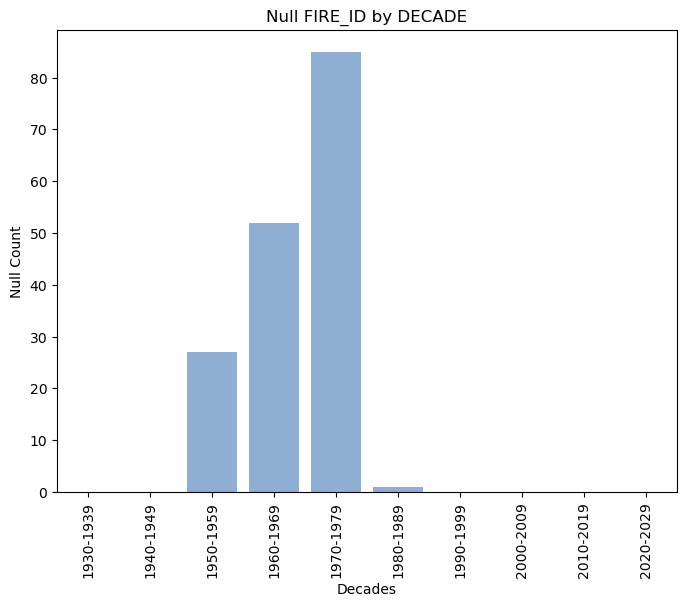

Total null count is 165.
DECADE
1930-1939     0
1940-1949     0
1950-1959    27
1960-1969    52
1970-1979    85
1980-1989     1
1990-1999     0
2000-2009     0
2010-2019     0
2020-2029     0
Name: FIRE_ID, dtype: int64


In [8]:
# Grouping `FIRE_ID` by decade 
fire_id_null = df_fire.groupby('DECADE')['FIRE_ID'].apply(lambda x: x.isna().sum())

plt.figure(figsize=(8,6))
sns.barplot(x=fire_id_null.index, y=fire_id_null.values, color='#83afde')
plt.xticks(rotation='vertical')
plt.title('Null FIRE_ID by DECADE')
plt.xlabel('Decades')
plt.ylabel('Null Count')
plt.show()

# Printing total null values for `FIRE_ID` and value counts
print(f"Total null count is {df_fire['FIRE_ID'].isna().sum()}.")
print(fire_id_null)

Insights from Null FIRE_ID by DECADE graph:
1. The missing values in `FIRE_ID` feature are only found in 3 decades. 1970's had the largest amount of missing values at 85 occurances.
2. It is followed by the 1960's then 1950's with 52 and 27 missing values respectively.
3. Since the missing data only represents less than 1%, it centers around the older decades and have string type values, we will assign 'unknown' to fill in the missing values in the `FIRE_ID` feature.

In [9]:
# Code filling in the value of 'unknown' for NaN in `FIRE_ID` 
df_fire['FIRE_ID'].fillna('unknown', inplace=True)

# Sanity check: 0 return value means no more null values
print(f" There are {df_fire['FIRE_ID'].isna().sum()} null values in the FIRE_ID columns")

 There are 0 null values in the FIRE_ID columns


#### FIRENAME`

In [10]:
# looking at null counts 
df_fire['FIRENAME'].isna().sum()

1

Since there is only 1 missing value for the FIRENAME. We will enter a value of 'unknown' since it should have minimal affect on the data. 

In [11]:
# Code filling in the value of 'unknown' for NaN in `FIRENAME` 
df_fire['FIRENAME'].fillna('unknown', inplace=True)

# Sanity check: 0 return value means no more null values
print(f" There are {df_fire['FIRENAME'].isna().sum()} null values in the `FIRENAME` columns")

 There are 0 null values in the `FIRENAME` columns


#### REP_DATE

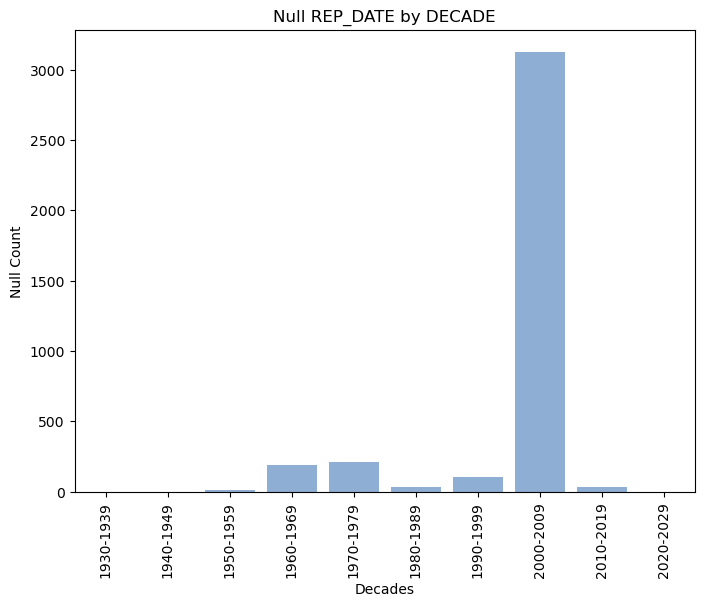

Total null count is 3713.
DECADE
1930-1939       0
1940-1949       0
1950-1959      10
1960-1969     188
1970-1979     213
1980-1989      38
1990-1999     102
2000-2009    3127
2010-2019      34
2020-2029       1
Name: REP_DATE, dtype: int64


In [12]:
# Grouping `REP_DATE` by decade 
rep_date_null = df_fire.groupby('DECADE')['REP_DATE'].apply(lambda x: x.isna().sum())

# Plotting null value counts
plt.figure(figsize=(8,6))
sns.barplot(x=rep_date_null.index, y=rep_date_null.values, color='#83afde')
plt.xticks(rotation='vertical')
plt.title('Null REP_DATE by DECADE')
plt.xlabel('Decades')
plt.ylabel('Null Count')
plt.show()

# Printing total null values for `FIRE_ID` and value counts
print(f"Total null count is {df_fire['REP_DATE'].isna().sum()}.")
print(rep_date_null)

Insights from Null REP_DATE by DECADE graph: 
1. The null values are spread out amongst multiple decades. There are a total of 3713 instances with null values in the feature.
2. The 2000's have by far the most at 3127 null values. It is unclear as to why this would occur. The data on `YEAR`, `MONTH`, and `DAY` seem to be similar to the `REP_DATE` based on a quick look at the first 5 lines of the data set.\
3. We will investigate if this assumption is a suitable way of filling the missing `REP_DATE` values. We will begin the analysis by doing a quick check at values in the `YEAR`, `MONTH`, and `DAY` columns. 

In [13]:
# Quick look at values to determine any inconsistencies
df_fire[['YEAR', 'MONTH', 'DAY']].describe()

,YEAR,MONTH,DAY
count,423831.000000,423831.000000,423831.000000
mean,1990.464784,6.585818,15.441048
std,47.872423,1.675279,8.983980
min,-999.000000,0.000000,0.000000
25%,1979.000000,5.000000,8.000000
50%,1991.000000,7.000000,15.000000
75%,2005.000000,8.000000,23.000000
max,2021.000000,12.000000,31.000000


We need to look into the `YEAR` column a bit more closely. It seems like the min value in that column is -999. The data source describes that the earliest data collected is in the 1930s. The min value of the day and month should also not be at 0. 

In [14]:
# Creating a filtered database to see errors. 
year_error = df_fire[df_fire['YEAR'] < 1930]

# Quick look at the data
year_error

,SRC_AGENCY,FIRE_ID,FIRENAME,LATITUDE,LONGITUDE,YEAR,MONTH,DAY,REP_DATE,DECADE,...,MORE_INFO,CFS_REF_ID,CFS_NOTE1,CFS_NOTE2,ACQ_DATE,SRC_AGY2,ECOZONE,ECOZ_REF,ECOZ_NAME,ECOZ_NOM
FID,,,,,,,,,,,,,,,,,,,,,
400991,YT,9900OC999,,0.000000,0.000000,-999,0,0,NaN,2000-2009,...,,YT--999-9900OC999,lat/long coords n/a,Exact year of fire unknown. Refer to decade,2016-06-16 00:00:00,YT,4,4,Taiga Plain,Taiga des plaines
400992,YT,9990OC099,,0.000000,0.000000,-999,0,0,NaN,1990-1999,...,,YT--999-9990OC099,lat/long coords n/a,Exact year of fire unknown. Refer to decade,2016-06-16 00:00:00,YT,4,4,Taiga Plain,Taiga des plaines
400993,YT,9990OC098,,0.000000,0.000000,-999,0,0,NaN,1990-1999,...,,YT--999-9990OC098,lat/long coords n/a,Exact year of fire unknown. Refer to decade,2016-06-16 00:00:00,YT,4,4,Taiga Plain,Taiga des plaines
400994,YT,9990OC007,,66.249368,-134.241586,-999,0,0,NaN,1990-1999,...,,YT--999-9990OC007,Exact year of fire unknown. Refer to decade,,2016-06-16 00:00:00,YT,4,4,Taiga Plain,Taiga des plaines
400995,YT,9990OC009,,66.299131,-134.169683,-999,0,0,NaN,1990-1999,...,,YT--999-9990OC009,Exact year of fire unknown. Refer to decade,,2016-06-16 00:00:00,YT,4,4,Taiga Plain,Taiga des plaines
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
405199,YT,9990WL009,,60.649179,-125.864257,-999,0,0,NaN,1990-1999,...,,YT--999-9990WL009,Exact year of fire unknown. Refer to decade,,2016-06-16 00:00:00,YT,12,12,Boreal Cordillera,CordillCre boreale
405295,YT,9950WL001,,60.174191,-125.256812,-999,0,0,NaN,1950-1959,...,,YT--999-9950WL001,Exact year of fire unknown. Refer to decade,,2016-06-16 00:00:00,YT,12,12,Boreal Cordillera,CordillCre boreale
405296,YT,9960WL002,,60.310713,-125.410001,-999,0,0,NaN,1960-1969,...,,YT--999-9960WL002,Exact year of fire unknown. Refer to decade,,2016-06-16 00:00:00,YT,12,12,Boreal Cordillera,CordillCre boreale


There are 95 occurances where the year is below 1930. There are a lot of fires from the Yukon Teritory. These occurances also are giving a value of 0 to Month and Date. Based on the `CFS_NOTE` columns. It seems that the reporting agency does not have any information on the exact year but only the decade it happened. This could be because of a loss of data, incorrect record keeping, or human error. Since there is no way for us to accurately predict the date for these occurances, we will drop these occurances. 

In [15]:
# Dropping occurances where `YEAR` is less than 1930
df_fire = df_fire.loc[df_fire['YEAR'] >= 1930]

# Checking data again
df_fire[['YEAR', 'MONTH', 'DAY']].describe()

,YEAR,MONTH,DAY
count,423736.000000,423736.000000,423736.000000
mean,1991.135011,6.587295,15.444510
std,16.976744,1.672562,8.982011
min,1930.000000,0.000000,0.000000
25%,1979.000000,5.000000,8.000000
50%,1991.000000,7.000000,15.000000
75%,2005.000000,8.000000,23.000000
max,2021.000000,12.000000,31.000000


There are still a few occurances where the `MONTH` and `DAY` value is 0. We will look into these further.

In [16]:
# Creating a filtered database to see errors. 
month_error = df_fire[df_fire['MONTH'] < 1]

# Quick look at the data
month_error

,SRC_AGENCY,FIRE_ID,FIRENAME,LATITUDE,LONGITUDE,YEAR,MONTH,DAY,REP_DATE,DECADE,...,MORE_INFO,CFS_REF_ID,CFS_NOTE1,CFS_NOTE2,ACQ_DATE,SRC_AGY2,ECOZONE,ECOZ_REF,ECOZ_NAME,ECOZ_NOM
FID,,,,,,,,,,,,,,,,,,,,,
100060,BC,1998-G90060,,58.0833,-122.7000,1998,0,0,NaN,1990-1999,...,,BC-1998-1998-G90060,,,2020-05-05 00:00:00,BC,4,4,Taiga Plain,Taiga des plaines
100072,BC,1998-G90217,,58.5667,-120.2167,1998,0,0,NaN,1990-1999,...,,BC-1998-1998-G90217,,,2020-05-05 00:00:00,BC,4,4,Taiga Plain,Taiga des plaines
100140,BC,1998-G80148,,57.8500,-120.2333,1998,0,0,NaN,1990-1999,...,,BC-1998-1998-G80148,,,2020-05-05 00:00:00,BC,9,9,Boreal PLain,Plaines bornales
100217,BC,1998-G90471,,55.8833,-120.5000,1998,0,0,NaN,1990-1999,...,,BC-1998-1998-G90471,,,2020-05-05 00:00:00,BC,9,9,Boreal PLain,Plaines bornales
105111,BC,1998-G60186,,57.2333,-125.6333,1998,0,0,NaN,1990-1999,...,,BC-1998-1998-G60186,,,2020-05-05 00:00:00,BC,12,12,Boreal Cordillera,CordillCre boreale
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
423443,PC-BP,2008-BP-1,Katherine Welch,45.2453,-81.5261,2008,0,0,NaN,2000-2009,...,,PC-BP-2008-BP-1,,,2010-11-25 00:00:00,PC,8,8,MixedWood Plain,Plaines d forits mixtes
423448,PC-LO,2009-LO-1,North Shore,45.9047,-59.9878,2009,0,0,NaN,2000-2009,...,,PC-LO-2009-LO-1,,Note that src coordinates outside Park/agency ...,2010-11-25 00:00:00,PC,7,7,Atlantic Maritime,Maritime de l'Atlantique
423532,PC-LM,2009-LM-1,La Terrasse,42.0000,-72.0000,2009,0,0,NaN,2000-2009,...,,PC-LM-2009-LM-1,src lat/lon coords outside agency boundary,switched lat/long coord - still incorrect loc,2010-11-25 00:00:00,PC,0,,,


There is no infromation available in the `CFS_NOTE` columns about why the months and days are still missing. There is no useful information in the other features as well to give us a clue which month/day the occurances correspond to. Becasue of these reasons, we will use the mean of the data to replace the '0' values in both features. 

In [17]:
# Changing min values from 0 to mean for `MONTH` and `DAY` column
df_fire['MONTH'].mask(df_fire['MONTH'] == 0, 6, inplace=True)
df_fire['DAY'].mask(df_fire['DAY'] == 0, 15, inplace=True)

df_fire[['YEAR', 'MONTH', 'DAY']].describe()

,YEAR,MONTH,DAY
count,423736.000000,423736.000000,423736.000000
mean,1991.135011,6.633965,15.572585
std,16.976744,1.568580,8.867081
min,1930.000000,1.000000,1.000000
25%,1979.000000,5.000000,8.000000
50%,1991.000000,7.000000,15.000000
75%,2005.000000,8.000000,23.000000
max,2021.000000,12.000000,31.000000


The min, max, and mean values for all thre columns look good. Now that all values from the `YEAR`, `MONTH`, and `DAY` columns have been fixed. We can proceed with looking at the `REP_DATE` column.

In [18]:
# Changing `REP_DATE` into a datetime format for better manipulation
df_fire['REP_DATE'] = pd.to_datetime(df_fire['REP_DATE'])

# Copying data to do further analysis
year_df = df_fire[['YEAR', 'MONTH', 'DAY', 'REP_DATE']]

# Extracting month data from datetime values
year_df['EXTRACTED_MONTH'] = year_df['REP_DATE'].dt.month

# Filling missing values with '13' because there is no 13th month
year_df['EXTRACTED_MONTH'].fillna(13, inplace=True)

# Checking if values in both `MONTH` columns are the same
(year_df['EXTRACTED_MONTH'] == year_df['MONTH']).value_counts()

C:\Users\nicod\AppData\Local\Temp\ipykernel_24656\437023235.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  year_df['EXTRACTED_MONTH'] = year_df['REP_DATE'].dt.month
C:\Users\nicod\AppData\Local\Temp\ipykernel_24656\437023235.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  year_df['EXTRACTED_MONTH'].fillna(13, inplace=True)


True     419983
False      3753
dtype: int64

Out of 3713 missing values, it looks like there is an additional 135 (3848-3713) occurances where the value in the `MONTH` column does not match the extracted month value from the `REP_DATE` column. Although it is a very small number given the number of correctly matching values, the fire season isn't that long so it could be entirely possible that the values just match up. We will look further into the `DAY` column to see if our assumption holds true. 

In [19]:
# Extracting date data from datetime values
year_df['EXTRACTED_DAY'] = year_df['REP_DATE'].dt.day

# Filling missing values with '32' because there is no 32nd day
year_df['EXTRACTED_DAY'].fillna(32, inplace=True)

# Checking if values in both `DAY` columns are the same
(year_df['EXTRACTED_DAY'] == year_df['DAY']).value_counts()

C:\Users\nicod\AppData\Local\Temp\ipykernel_24656\393949869.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  year_df['EXTRACTED_DAY'] = year_df['REP_DATE'].dt.day
C:\Users\nicod\AppData\Local\Temp\ipykernel_24656\393949869.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  year_df['EXTRACTED_DAY'].fillna(32, inplace=True)


True     419534
False      4202
dtype: int64

Out of the 3713 missing values, it looks like there is an additional 584 (4297-3713) occurances where the value in the DAY column does not match the extracted day value from the REP_DATE column. Since the error only represents 0.13% of the data, it is safe to assume that the `YEAR`, `MONTH`, and `DAY` columns are a good combination to create the missing values in the `REP_DATE` column. 

In [20]:
# Code filling in the value of 'unknown' for NaN in `FIRENAME` 
df_fire['REP_DATE'].fillna( pd.to_datetime(df_fire[['YEAR', 'MONTH', 'DAY']]), inplace=True)

# Sanity check
print(f" There are {df_fire['REP_DATE'].isna().sum()} null values in the `REP_DATE` column")

 There are 0 null values in the `REP_DATE` column


#### CAUSE

In [21]:
# Looking at null count of `CAUSE`
df_fire['CAUSE'].isna().sum()

241

There are only 241 occurances of null values in the `CAUSE` column. 

In [22]:
# Looking at value counts for causes
df_fire['CAUSE'].value_counts()

H       230498
L       183179
U         9422
H-PB       322
RE          74
Name: CAUSE, dtype: int64

We have 5 classes for cause. They are human(H), lightning(L), unknown(U), human prescribed burn(H-PB), reignited(RE). Since we have an `Undertermined` cause in our data already, we will add the change the `null` values to `undetermined`.

In [23]:
# Filling `CAUSE` null values
df_fire['CAUSE'].fillna('U', inplace=True)

# Quality check
print(f" There are {df_fire['CAUSE'].isna().sum()} null values in the `CAUSE` column")

 There are 0 null values in the `CAUSE` column


#### PROTZONE

In [24]:
# Looking at null count of `PROTZONE`
print(f"There are {df_fire['PROTZONE'].isna().sum()} null values in the `PROTZONE` feature")

There are 1010 null values in the `PROTZONE` feature


In [25]:
# We will look at the unique values 
df_fire['PROTZONE'].value_counts()

                         333368
Intensive                 62725
EXT                        4242
Initial Attack             3158
Monitored                  3117
Nordique                   2784
R (High Priority)          2745
FUL                        1568
G (Low Priority)           1327
W (Observation Zone)       1062
Full Response               906
Sustained Action            890
Wilderness FMZ              857
intensive                   663
MON                         539
Modified Response           399
FullResponse                289
Full FMZ                    278
Critical FMZ                248
Delayed Action              239
Stratigic FMZ               197
Transition FMZ              170
ActionCode: 1               150
Limited Action              148
Y (Moderate Priority)       111
Prescribed Fire             108
Being Monitored              87
nordique                     77
Wilderness (forested)        68
Monitored Response           51
MOD                          47
ActionCo

There are multiple response types for fires. Since there are 1010 null values that we cannot resonably assume the response type, we will classify them as unknown.

In [26]:
# Filling `PROTZONE` null values
df_fire['PROTZONE'].fillna('Unknown', inplace=True)

# Quality check
print(f" There are {df_fire['PROTZONE'].isna().sum()} null values in the PROTZONE` column")

 There are 0 null values in the PROTZONE` column


#### ACQ_DATE

In [27]:
print(f" There are {df_fire['ACQ_DATE'].isna().sum()} null values in the `ACQ_DATE` feature")

 There are 10605 null values in the `ACQ_DATE` feature


In [28]:
# Looking at unique values
df_fire['ACQ_DATE'].value_counts()

2020-05-05 00:00:00    147093
2020-04-03 00:00:00     82494
2020-06-01 00:00:00     60545
2018-05-18 00:00:00     41067
2008-07-24 00:00:00     17549
                        ...  
2011-02-02 00:00:00         6
2016-09-22 00:00:00         3
2014-06-24 00:00:00         2
1899-12-30 00:00:00         1
2015-08-17 00:00:00         1
Name: ACQ_DATE, Length: 90, dtype: int64

Since the values in the `ACQ_DATE` column only describe when the data was given/collected, it holds no value for predicting wildland fires. There is no other features that could give us an idea of when the data was acquired. Because of all this, we are going to drop this feature. 

In [29]:
# Dropping `ACQ_DATE` column
df_fire.drop(columns=['ACQ_DATE'], inplace=True)

# Sanity check
df_fire.isna().sum()

SRC_AGENCY    0
FIRE_ID       0
FIRENAME      0
LATITUDE      0
LONGITUDE     0
YEAR          0
MONTH         0
DAY           0
REP_DATE      0
DECADE        0
SIZE_HA       0
CAUSE         0
PROTZONE      0
FIRE_TYPE     0
MORE_INFO     0
CFS_REF_ID    0
CFS_NOTE1     0
CFS_NOTE2     0
SRC_AGY2      0
ECOZONE       0
ECOZ_REF      0
ECOZ_NAME     0
ECOZ_NOM      0
dtype: int64

There are no more null values in our fire dataset. 

### Weather Data

In [30]:
# Looking at value types before null values
df_weather.isna().sum()

Date           0
Long           0
Lat            0
Stn_Name       0
Clim_ID        0
Prov_or_Ter    0
Tm             0
DwTm           0
Tx             0
DwTx           0
Tn             0
DwTn           0
S              0
DwS            0
P              0
DwP            0
Pd             0
HDD            0
CDD            0
dtype: int64

Although we have already cleaned our weather data in another notebook. We just wanted to double check that there are no NaN values.

## Duplicates <a id="1.4"></a>

In [31]:
# Checking for duplicated rows
df_fire.duplicated().sum()

4

There are 4 duplicated rows in our data set. Since it is highly unlikely that all the values in all the features are exactly the same. There are certain features that are extremly hard to duplicate like longitude/latitude and date. 

In [32]:
# Dropping duplicates
df_fire = df_fire.drop_duplicates(keep='last')

# Sanity check. It should print 0 if there are no duplicates
print(f"There are {df_fire.duplicated().sum()} duplicate occurances in the dataset")

There are 0 duplicate occurances in the dataset


The `SRC_AGY2` is a duplicate of the `SRC_AGENCY`. However, based on inital exploration, `ECOZ_NAME` was also the same as `ECOZ_NOM`. The latter contains the french translation. We will drop `ECOZ_NOM` as well.

In [33]:
# Looking at unique values and counts of `ECOZONE` and `ECOZ_REF`
fig = go.Figure()
ECOZONE_bar = go.Bar(x=df_fire['ECOZONE'].value_counts().index, 
                     y=df_fire['ECOZONE'].value_counts().values, 
                     text=df_fire['ECOZONE'].value_counts(normalize=True).values*100, 
                     name='ECO ZONE')
ECOZ_REF_bar = go.Bar(x=df_fire['ECOZ_REF'].value_counts().index, 
                      y=df_fire['ECOZ_REF'].value_counts().values, 
                      text=df_fire['ECOZ_REF'].value_counts(normalize=True).values*100, 
                      name='ECOZ_REF')
ECOZONE_chart_layout = go.Layout(title='ECOZONE Distribution w/ Percentages', 
                                 xaxis_title='ECOZONE', 
                                 yaxis_title='Frequency')
fig.add_trace(ECOZONE_bar)     
fig.add_trace(ECOZ_REF_bar)   
fig.update_layout(ECOZONE_chart_layout)

It seems like some of the `ECOZ_REF` are further divided into subcategories. We will focus on the main `ECOZONE` and therefore drop the `ECOZ_REF` feature.

In [34]:
# Dropping columns 'SRC_AGY2', 'ECOZ_NOM' and `ECOZ_REF`
df_fire.drop(columns=['SRC_AGY2'], inplace=True)
df_fire.drop(columns=['ECOZ_NOM'], inplace=True)
df_fire.drop(columns=['ECOZ_REF'], inplace=True)

In [35]:
# Checking for duplicates in weather dataset
df_weather.duplicated().sum()

0

There are no more duplicates in both data sets.

## Data Insights <a id="1.5"></a>

Now that we have cleaned our data, we will summarize a few of our insights.
1. The fire and weather data was acquired from the Government of Canada Database. The federal government has compiled the data provided by provincial government bodies. 
2. Although the data is continiously updated, there is no current update past 2021. We will have to split our existing data to test our predictions.
3. The fire data had quality issues since different reporting agencies recorded information differently. We had to drop features due to a lack of information provided. There is an opportunity for the federal government to take the lead in creating a standard for reporting wildland fire occurances.
4. The biggest challenge is merging the fire data and the weather data since we have to find the closest weather station to fire occurance to get the most accurate weather information.
5. Future feature additions could be topography, wind conditions, moisture content, and humidity could be great additions to the data to get a more comprehensive weather overview.


# EDA <a id="2"></a>

We will be begin our exploring both our data sets to gain inital insights.

## Univariate Analysis on Fire Data <a id="2.1"></a>

`SRC_AGENCY`

In [36]:
# Creating bar chart for `SRC_AGENCY` distribution
fig = go.Figure()
SRC_AGENCY_bar = go.Bar(x=df_fire['SRC_AGENCY'].value_counts().index, 
             y=df_fire['SRC_AGENCY'].value_counts().values, name='Bar')
SRC_AGENCY_chart_layout = go.Layout(title='SRC_AGENCY Distribution', 
                         xaxis_title='SRC_AGENCY',
                        yaxis_title='Frequency')
fig.add_trace(SRC_AGENCY_bar)
fig.update_layout(SRC_AGENCY_chart_layout)

The `SRC_AGENCY`feature shows us the government body that has contributed the data. Since most of the government bodies are by province or teritory, it also gives us a glimpse of where the most wildfires are located. British Columbia has by far the most wildland fire occurances with over 149k reported over the past years. It is followed by Alberta with ~63k occurances. The least amount of occurances are dominated by Parks Canada (PC). It seems like Parks Canada has separated their reporting by individual national parks (ie. PC-WB for Wood Buffalo, PC-BA for Banff, PC-JA for Jasper, PC-YO for Yoho). Although they represent different parts of Canada, the longitude/latitude columns should still be able to give us a more specific location data. To better understand the data, we will group all the different entries for Parks Canada locations into a single group. 

In [37]:
# looking at all unique values in `SRC_AGENCY` column
df_fire['SRC_AGENCY'].value_counts()

BC          149410
ON           63508
AB           62706
QC           43124
MB           27506
SK           25287
NT           14365
NB           11041
NS           10451
YT            7966
NL            4371
PC-WB         1961
PC-BA          353
PC-JA          259
PC-GF          167
PC-KO          147
PC-GR          145
PC-PA          130
PC-GL          106
PC-RM           92
PC-NA           78
PC-YO           75
PC-WL           65
PC-LM           60
PC-PU           59
PC-RE           49
PC-EI           35
PC-KG           30
PC-PP           26
PC-GI           20
PC-CB           17
PC-TN           17
PC-KE           14
PC-BP           12
PC-TI           10
PC-SL            8
PC-BT            8
PC-WP            8
PC-FO            6
PC-KL            5
PC-PE            4
PC-FU            3
PC-LO            3
PC-FR            3
PC-RE-GL         3
PC-SY            3
PC-VU            3
PC-GB            2
PC-RO            2
PC-MM            2
PC-TH            2
PC-GM            1
PC-PR       

In [38]:
# Chaning all the individual PC-xx to PC using map
df_fire['SRC_AGENCY'] = df_fire['SRC_AGENCY'].map(
    {'BC': 'BC', 'ON': 'ON', 'AB': 'AB', 'QC': 'QC',
     'MB': 'MB', 'SK': 'SK', 'NT': 'NT', 'NB': 'NB',
     'NS': 'NS', 'YT': 'YT', 'NL': 'NL', 'PC-WB': 'PC',
     'PC-BA': 'PC', 'PC-JA': 'PC', 'PC-GF': 'PC',
     'PC-KO': 'PC', 'PC-GR': 'PC', 'PC-PA': 'PC',
     'PC-GL': 'PC', 'PC-RM': 'PC', 'PC-NA': 'PC',
     'PC-YO': 'PC', 'PC-WL': 'PC', 'PC-LM': 'PC',
     'PC-PU': 'PC', 'PC-RE': 'PC', 'PC-EI': 'PC',
     'PC-KG': 'PC', 'PC-PP': 'PC', 'PC-GI': 'PC',
     'PC-CB': 'PC', 'PC-TN': 'PC', 'PC-KE': 'PC',
     'PC-BP': 'PC', 'PC-TI': 'PC', 'PC-SL': 'PC',
     'PC-BT': 'PC', 'PC-WP': 'PC', 'PC-FO': 'PC',
     'PC-KL': 'PC', 'PC-PE': 'PC', 'PC-FU': 'PC',
     'PC-LO': 'PC', 'PC-FR': 'PC', 'PC-RE-GL': 'PC',
     'PC-SY': 'PC', 'PC-VU': 'PC', 'PC-GB': 'PC',
     'PC-RO': 'PC', 'PC-MM': 'PC', 'PC-TH': 'PC',
     'PC-GM': 'PC', 'PC-PR': 'PC', 'PC-NC': 'PC',
     'PC-FW': 'PC', 'PC-SE': 'PC'})

# Sanity check
df_fire['SRC_AGENCY'].value_counts(normalize=True)*100

BC    35.260495
ON    14.987775
AB    14.798505
QC    10.177187
MB     6.491367
SK     5.967687
NT     3.390115
NB     2.605656
NS     2.466417
YT     1.879962
NL     1.031548
PC     0.943285
Name: SRC_AGENCY, dtype: float64

In [39]:
# Recreating bar chart for `SRC_AGENCY` distribution
fig = go.Figure()
SRC_AGENCY_bar = go.Bar(x=df_fire['SRC_AGENCY'].value_counts().index, 
             y=df_fire['SRC_AGENCY'].value_counts().values, name='Bar')
SRC_AGENCY_chart_layout = go.Layout(title='Restructured SRC_AGENCY Distribution', 
                         xaxis_title='SRC_AGENCY',
                        yaxis_title='Frequency')
fig.add_trace(SRC_AGENCY_bar)
fig.update_layout(SRC_AGENCY_chart_layout)

All the entries for individual parks in Canada have now been consolidated into PC (Parks Canada). This should give us better visibility to the data. We have reduced the number of unique values in the `SRC_AGENCY` column to 12. Parks Canada still has the lowest number of reported wildland fires comprising only 0.94% of overall occurances. BC has 35% of all reported wildland fires. BC's geography could also be contributing the reason for having the most wildland fires. The province of BC occupies what is knows as the Cordillera region. It is a vast thickly foreseted area of enermous mountain ranges, deep valleys, and long rivers. 
Resource: https://thecanadaguide.com/places/british-columbia/#:~:text=B.C.'s%20geography%20is%20so,deep%20valleys%20and%20long%20rivers.

`DECADE`

In [40]:
# Creating bar chart for `DECADE` distribution
fig = go.Figure()
DECADE_bar = go.Bar(x=df_fire['DECADE'].value_counts().index, 
             y=df_fire['DECADE'].value_counts().values, name='Bar')
DECADE_chart_layout = go.Layout(title='DECADE Distribution', 
                         xaxis_title='DECADE',
                        yaxis_title='Frequency')
fig.update_xaxes(categoryorder='array', 
                 categoryarray= ['1930-1939', '1940-1949', '1950-1959', '1960-1969', 
                                 '1970-1979', '1980-1989', '1990-1999', '2000-2009', 
                                 '2010-2019', '2020-2029'])
fig.add_trace(DECADE_bar)
fig.update_layout(DECADE_chart_layout)


A few observations from the `DECADE` column:
1. There are too few occurances recorded in the 1930s and 1940s. Based on the method of data collection, not all reporting agenecies had data during this time period. Some provencial governments started recording and reporting data from the 1950's onwards. 
2. There is a peak in the 1980s. It is surprising that the number of occurances has decreased after that. There were ~87k wildland fires reported that decade. The decrease of wildland fires could be due to the introduction of forest legislation. The Forest Management Act was enacted in 1986. The Department of Forestry was established in 1989. 
3. There has been a slight decline on the number of occurances since the 1980s.
4. Data for the 2020's is still incomplete because the latest data contained in the dataset is from 2021.
Resource: chrome-extension://efaidnbmnnnibpcajpcglclefindmkaj/https://prism.ucalgary.ca/server/api/core/bitstreams/81c7ff23-a9df-44dc-9625-31a0d99e6436/content

In [41]:
# Dropping all rows from the 1930's
df_fire = df_fire[df_fire['DECADE'] != '1930-1939']

`YEAR`

In [42]:
# Creating bar chart for `YEAR` distribution
fig = go.Figure()
YEAR_bar = go.Bar(x=df_fire['YEAR'].value_counts().index, 
             y=df_fire['YEAR'].value_counts().values, name='Bar')
YEAR_chart_layout = go.Layout(title='YEAR Distribution', 
                         xaxis_title='YEAR',
                        yaxis_title='Frequency')

fig.add_trace(YEAR_bar)
fig.update_layout(YEAR_chart_layout)

Similar to the decade feature, we can see a peak of forest fire occurances in 1989 with ~12k occurances. Although there is a slight increase of occurances from the 1950s to 1989 and then a slight decrease from 1990 onwards, there seem to be a lot more volatility after 1990. We see years with huge spikes in occurances followed by massive dips the next year (ie 1992-1993, 1998-1999, and 2018-2019). It seems the 1990s, 2000s, and 2010s have been more unpredictable for couting occurances. 

`MONTH`

In [43]:
# looking at basic numbers for the `SIZE_HA` feature
df_fire['MONTH'].describe()

count    423731.000000
mean          6.633973
std           1.568578
min           1.000000
25%           5.000000
50%           7.000000
75%           8.000000
max          12.000000
Name: MONTH, dtype: float64

Observations based on number values:
1. There are fires recorded from January to December. This is because the min value is 1 and the max value is 12. 
2. The 50th percentile and the mean are very close to each other. Most of the fire occurances happen late into June into September. 

In [44]:
# Creating bar chart for `MONTH` distribution
fig = go.Figure()
MONTH_bar = go.Bar(x=df_fire['MONTH'].value_counts().index, 
             y=df_fire['MONTH'].value_counts().values, name='Bar')
MONTH_chart_layout = go.Layout(title='MONTH Distribution', 
                         xaxis_title='MONTH',
                        yaxis_title='Frequency')
fig.add_trace(MONTH_bar)
fig.update_layout(MONTH_chart_layout)

The month distribution is more predictable. The peak month for wildland fires is July. Occurances start ramping up in April as the weather gets hotter and peaks in the summer. As the weather gets cooler, the occurances also start dropping. What is interesting is the wildland fire occurances in Januray, February, November, and December. Further investigation is required as to the cause of the fires since it is normally too cold/wet during these months. There is a possibility that these wildland fires are caused by human activity. 

`CAUSE`

In [45]:
# Creating bar chart for `CAUSE` distribution
# With percentage values
fig = go.Figure()
CAUSE_bar = go.Bar(x=df_fire['CAUSE'].value_counts().index, 
                   y=df_fire['CAUSE'].value_counts().values, 
                   text=df_fire['CAUSE'].value_counts(normalize=True).values*100, name='Bar')
CAUSE_chart_layout = go.Layout(title='CAUSE Distribution w/ Percentages', 
                         xaxis_title='CAUSE',
                        yaxis_title='Frequency')
fig.add_trace(CAUSE_bar)       
fig.update_layout(CAUSE_chart_layout)

Human (H) caused wildland fires are the most common. It accounts for 54% of all occurances. Lightning (L) caused wildland fires account for 43%. Both human and lighting take the majority of all the wildland fires. There is a small percentage (~2.28%) of unknown causes. Provicial government, other agencies, and private land owners are also involved in prescribed burns (H-PB). Prescribed burns are planned and intentional use of fire on a specific land area. It is It is one of the most ecologically appropriate and relatively efficient means for achieving a range of objectives. These objectives can include habitat enhancement, preparation for tree planting or disease eradication.Prescribed fire can also contribute to achieving air quality and climate action targets by preventing large, intense wildfires and replacing them with more frequent, well-timed, well-planned low-intensity fires. 
Cultural burning exists in indigenous culture in helping maintain a healthy forest ecosystem amongst other reasons. 

`FIRE_TYPE`

In [46]:
# Creating bar chart for `FIRE_TYPE` distribution
fig = go.Figure()
FIRE_TYPE_bar = go.Bar(x=df_fire['FIRE_TYPE'].value_counts().index, 
                   y=df_fire['FIRE_TYPE'].value_counts().values, 
                   text=df_fire['FIRE_TYPE'].value_counts(normalize=True).values*100, name='Bar')
FIRE_TYPE_chart_layout = go.Layout(title='FIRE_TYPE Distribution w/ Percentages', 
                         xaxis_title='FIRE_TYPE',
                        yaxis_title='Frequency')
fig.add_trace(FIRE_TYPE_bar)       
fig.update_layout(FIRE_TYPE_chart_layout)

Although we already looked at and removed null values earlier, it seems that almost half the data has no value in it. It could have contained a "(space)" as its value. The data does not give us any useful information. The next most common `FIRE_TYPE` is just `Fire`. It does not diffenciate the kind of fire. The dataset also does not give any description on the rest of the values. Since the data was collected from multiple agencies/provincial governments, they could have their own classification for data. Based on the reasons above, we will drop this column since it gives us no clear classification of the data in the feautre.

In [47]:
# Dropping `FIRE_TYPE` column
df_fire.drop(columns=['FIRE_TYPE'], inplace=True)

`PROTZONE`

In [48]:
# Creating bar chart for `PROTZONE` distribution
fig = go.Figure()
PROTZONE_bar = go.Bar(x=df_fire['PROTZONE'].value_counts().index, 
                   y=df_fire['PROTZONE'].value_counts().values, 
                   text=df_fire['PROTZONE'].value_counts(normalize=True).values*100, name='Bar')
PROTZONE_chart_layout = go.Layout(title='PROTZONE Distribution w/ Percentages', 
                         xaxis_title='PROTZONE',
                        yaxis_title='Frequency')
fig.add_trace(PROTZONE_bar)       
fig.update_layout(PROTZONE_chart_layout)

Although we already looked at and removed null values earlier, it seems that ~78% has no value in it. It could have contained a "(space)" as its value. The data does not give us any useful information. The next most common PROTZONE is just Intensive. It does not diffenciate the kind of PROTZONE. The dataset also does not give any description on the rest of the values. Since the data was collected from multiple agencies/provincial governments, they could have their own classification for data. Based on the reasons above, we will drop this column since it gives us no clear classification of the data in the feautre.

In [49]:
# Dropping `PROTZONE` column
df_fire.drop(columns=['PROTZONE'], inplace=True)

`ECOZNAME`

In [50]:
# Creating bar chart for `ECOZ_NAME` distribution
fig = go.Figure()
ECOZ_NAME_bar = go.Bar(x=df_fire['ECOZ_NAME'].value_counts().index, 
                   y=df_fire['ECOZ_NAME'].value_counts().values, 
                   text=df_fire['ECOZ_NAME'].value_counts(normalize=True).values*100, name='Bar')
ECOZ_NAME_chart_layout = go.Layout(title='ECOZ_NAME Distribution w/ Percentages', 
                         xaxis_title='ECOZ_NAME',
                        yaxis_title='Frequency')
fig.add_trace(ECOZ_NAME_bar)       
fig.update_layout(ECOZ_NAME_chart_layout)

The Montane Cordillera is where ~28% of all wildland fires occur. This area occupies most of BC. The Boreal Plain which comes in second with ~18% of all occurances occupies most of AB and SK. A lot of the northern ecozones have very little wildland fire occurances. These ecozones incldue the Northern/Southern Arctic, Tiaga Cordillera, Tiaga Sheild, and Boreal Cordillera. Based on the given data, the type of ecosystem plays a huge part in forest fire risk. It could be because of the range in weather conditions or the type of vegetation in the area. 

`Longitude` & `Latitude`

`SIZE_HA`

In [51]:
# looking at basic numbers for the `SIZE_HA` feature
df_fire['SIZE_HA'].describe()

count    4.237310e+05
mean     3.161607e+02
std      5.617674e+03
min      0.000000e+00
25%      1.000000e-01
50%      1.000000e-01
75%      1.000000e+00
max      1.050000e+06
Name: SIZE_HA, dtype: float64

Looking at our target variable, we can see that the hectare size has an extremly big range. The minimum value is at 0 while the maximum value is over 1 million. The 1 hectare mark sits at our 75th percentile. Our target data is heavily skewed towards smaller fires. We will first deal with the rows where 0 hectares have been burned. It does not contribute any information when no land has been burned or affected by the wildland fire. 

In [52]:
# Looking at percentage of hectares with value of 0
(df_fire['SIZE_HA'] == 0).mean()*100

9.12276892651234

Since we are only dealing with 9% of our data with 0 hectares burned, we will drop these rows as it does not help us understand fire severity based on amount of area destroyed by wildland fire. 

In [53]:
# Dropping all rows with 0 value in `SIZE_HA`
df_fire = df_fire[df_fire['SIZE_HA'] != 0]

# Sanity check
(df_fire['SIZE_HA'] == 0).sum()

0

Now that we have removed all the occurances with 0 hectares burned, we will look into how we can bin our target variable to be able to analyze it better. 

In [54]:
# Creating scatter plot for `SIZE_HA` distribution
fig = px.scatter(data_frame=df_fire,x=df_fire['YEAR'], 
                   y=df_fire['SIZE_HA'])
SIZE_HA_chart_layout = go.Layout(title='SIZE in Hectares Distribution by Year', 
                         xaxis_title='Year',
                        yaxis_title='Hectares')       
fig.update_layout(SIZE_HA_chart_layout)
fig.show()      

We can see that most of the fire sizes are in the smaller range. There are a few fires that are close or over to a million hectares in size. We will further analyze the total hectares that have affected by wildland fires.

In [55]:
# Creating buckets for different fire sizes
small_fire = df_fire['SIZE_HA'] < 1
large_fire = df_fire['SIZE_HA'] >= 1

# Adding total hectares burned for fire size buckets
sm_area_burned = df_fire['SIZE_HA'][small_fire].sum()
lg_area_burned = df_fire['SIZE_HA'][large_fire].sum()
print(f" The total area burned by fires less than 200 hectares is {round(sm_area_burned, 2)}. It has {df_fire['SIZE_HA'][small_fire].count()} number of occurances")
print(f" The total area burned by fires larger than 200 hectares is {round(lg_area_burned, 2)}. It has {df_fire['SIZE_HA'][large_fire].count()} number of occurances")

 The total area burned by fires less than 200 hectares is 48186.8. It has 267962 number of occurances
 The total area burned by fires larger than 200 hectares is 133918914.58. It has 117113 number of occurances


We split the SIZE_HA feature into small and large. The definition are as follows.

Small: Size less than 200 hectares
Large: Size is greater than or equal to 200 hectares.
<br>
| Size | Area damaged HA| Number of occurances |
| ---- | -------------- | -------------------- |
|Small |   1,695,672    |        404668        |
|Large |  132,271,428   |         19064        |
<br>

With with only 19,064 occurances, Large wildland fires are 78x more destructive than small fires based on hectares damaged even though large wildland fires only account for 4.49% of all the data.

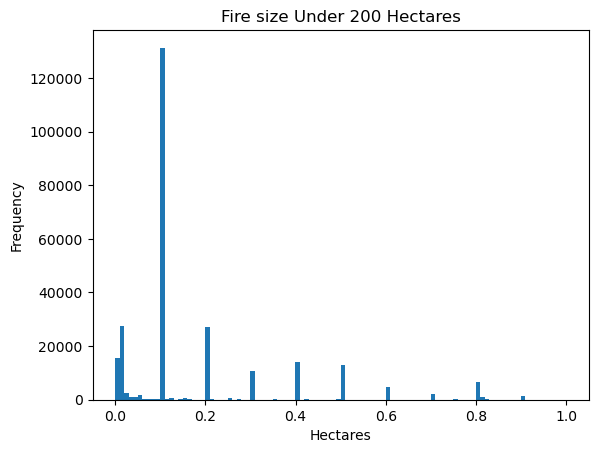

In [56]:
# Plotting small fires
plt.figure()
plt.hist(df_fire['SIZE_HA'][small_fire],bins=100)
plt.title('Fire size Under 200 Hectares')
plt.xlabel('Hectares')
plt.ylabel('Frequency')
plt.show()

We can see that the data is heavily skewed towards smaller fires. We might need a further look at the fire size to determine where most of the data is.

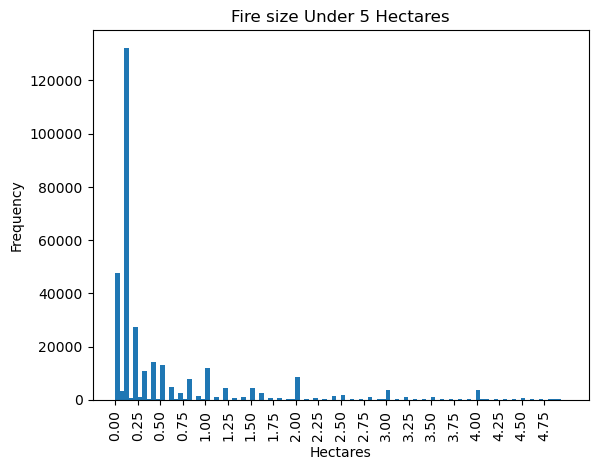

In [57]:
# Creating smaller bucket 
xsmall_fire = df_fire['SIZE_HA'] < 5

# Creating xticks
tick_list = np.arange(0, 5, 0.25)

# Plotting xsmall fires
plt.figure()
plt.hist(df_fire['SIZE_HA'][xsmall_fire],bins=100)
plt.title('Fire size Under 5 Hectares')
plt.xlabel('Hectares')
plt.ylabel('Frequency')
plt.xticks(tick_list, rotation=90)
plt.show()

Most of the occurances had less than 0.25 hectares. It has a downward slope after that. 

## Univariate Analysis on Weather Data <a id="2.2"></a>

`Date`

In [58]:
print(df_weather['Date'].describe())
print(f"The first recorded weather date is {df_weather['Date'].min()}")
print(f"The last recorded weather date is {df_weather['Date'].max()}")


count                 1209878
unique                    984
top       1989-06-01 00:00:00
freq                     2101
first     1940-01-01 00:00:00
last      2021-12-01 00:00:00
Name: Date, dtype: object
The first recorded weather date is 1940-01-01 00:00:00
The last recorded weather date is 2021-12-01 00:00:00


C:\Users\nicod\AppData\Local\Temp\ipykernel_24656\2442260583.py:1: FutureWarning:

Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.



We have 1.2 million entries in our data with 984 unique values. We know our weather data set contains monthly data of different weather stations. It seems like the month with the most complete weather station data is on June 1989. The earliest date in our weather data is January 1940 and the last date is December 2021. This would be the same as the timeframe of our dataset. 

`Clim_ID`: Climate identifier

In [59]:
# Looking at value counts
df_weather['Clim_ID'].value_counts()

1126510    980
5031320    979
1173210    978
1017230    977
1016940    976
          ... 
8206240      1
5060608      1
709CE9F      1
7060474      1
8200774      1
Name: Clim_ID, Length: 5644, dtype: int64

We have 5644 unique values. The climate identifiers are comprised of both number and letters. Since they are not a continious value and would be hard to binarize, we will drop this feature.

In [60]:
df_weather.drop(columns=['Clim_ID'], inplace=True)

`Stn_Name`

In [61]:
# Looking at unique value counts for `Stn_Name`
df_weather['Stn_Name'].value_counts()

WOODSTOCK                 1808
NEW GLASGOW               1343
ISLAND FALLS              1268
CARTWRIGHT                1128
RUSSELL                   1083
                          ... 
LAC SEUL                     1
LAC CHICOBI                  1
BARRIERE N CHIBOUGAMAU       1
BEATRICE CLIMATE             1
CARIBOU POINT (AUT)          1
Name: Stn_Name, Length: 5324, dtype: int64

There are 5324 unique weather stations. The weather station at Woodstock has the most number of entries. There are some weather stations that only have 1 entry to them. We will try to divide the weather stations by Province or Teritory to have a better idea of where they are. 

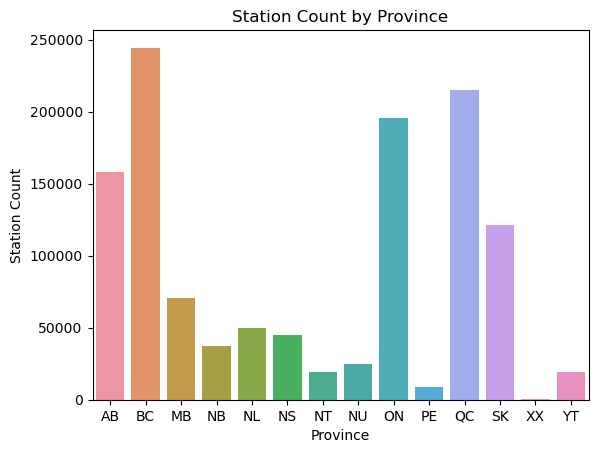

In [62]:
# Grouping weather stations by province
weather_station_grouped = df_weather.groupby('Prov_or_Ter')['Stn_Name'].count()

# Plotting the data
sns.barplot(x=weather_station_grouped.index, y=weather_station_grouped.values)
plt.xlabel('Province')
plt.ylabel('Station Count')
plt.title('Station Count by Province')
plt.show()

Observations from Stn_Name chart:
1. BC has the most weather stations followed by QC and ON.
2. The teritories YT, NU, and NT are amonng the areas with the lowest count of weather stations. This could be because of its remoteness or lack of infrastructure.
3. There are a few weather stations that are labeled as XX. Although we do not know their exact location, we will not drop the information they hold since the data was gathered from the Government of Canada data repository.

`Tm`: Mean Temperature

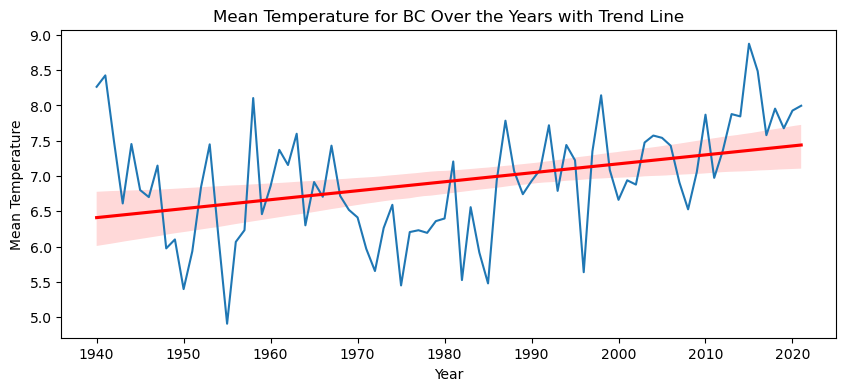

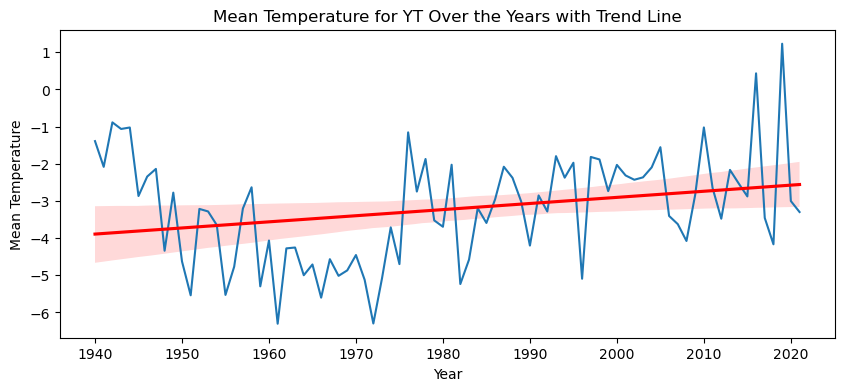

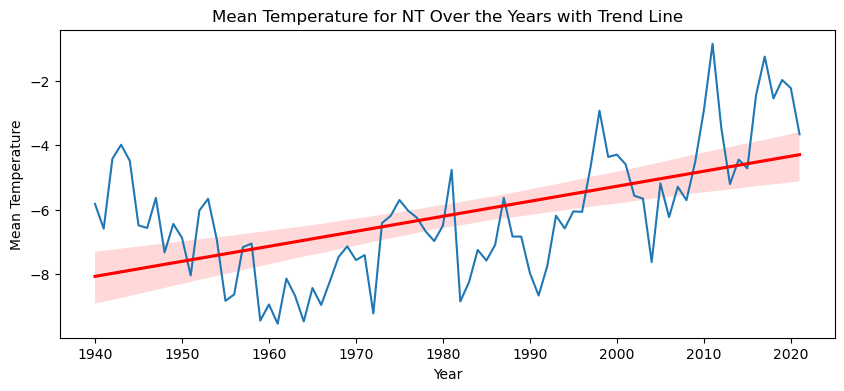

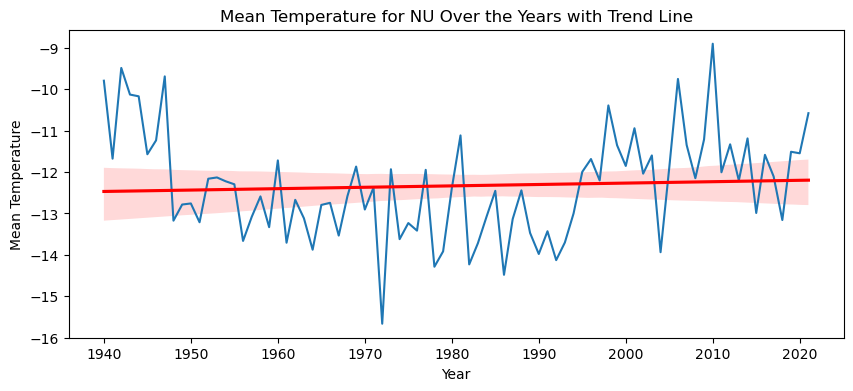

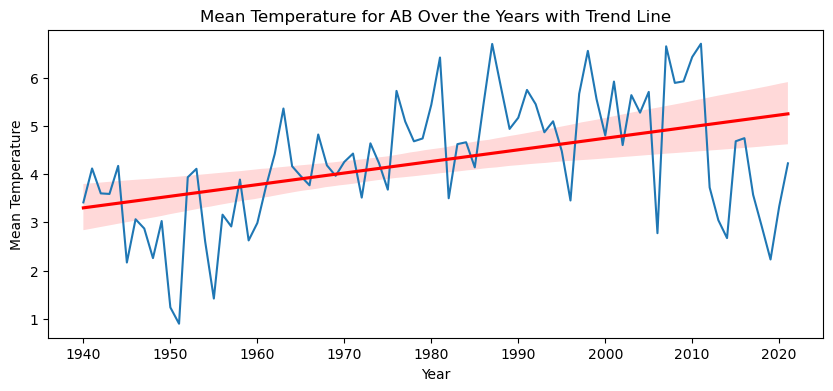

...

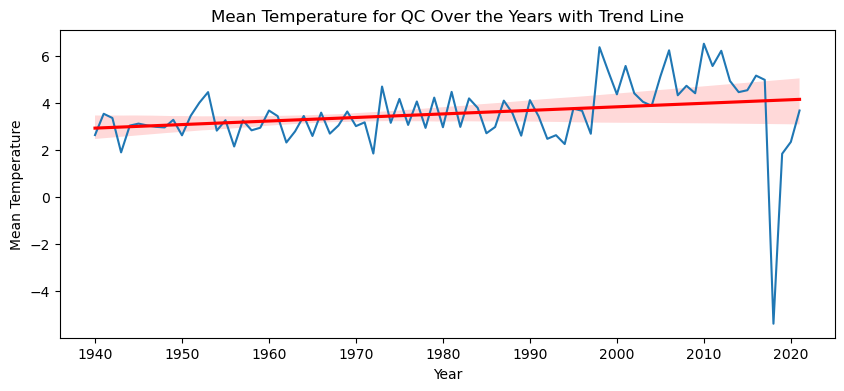

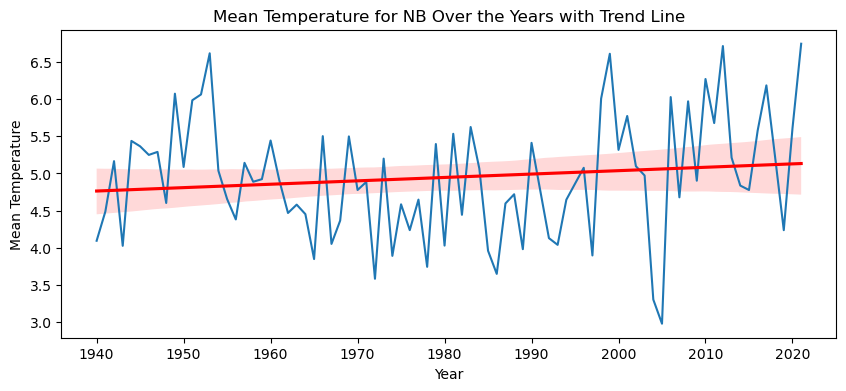

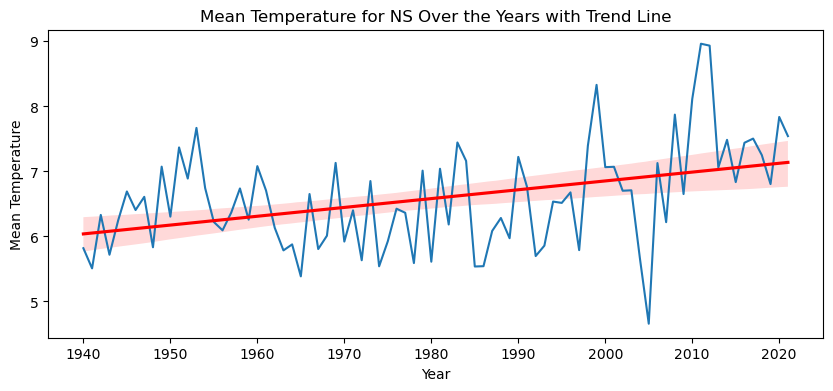

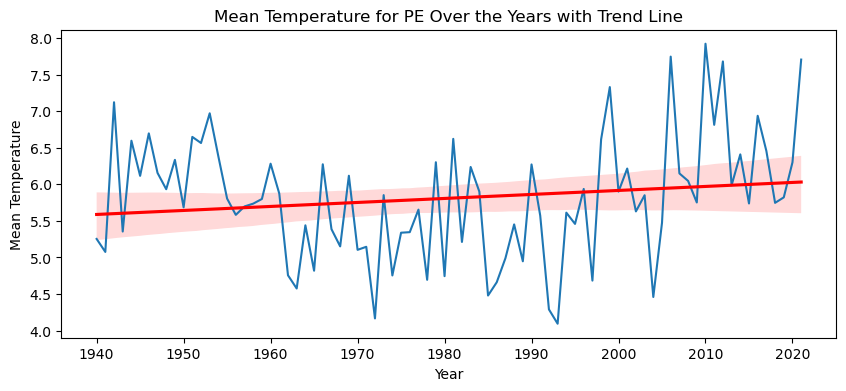

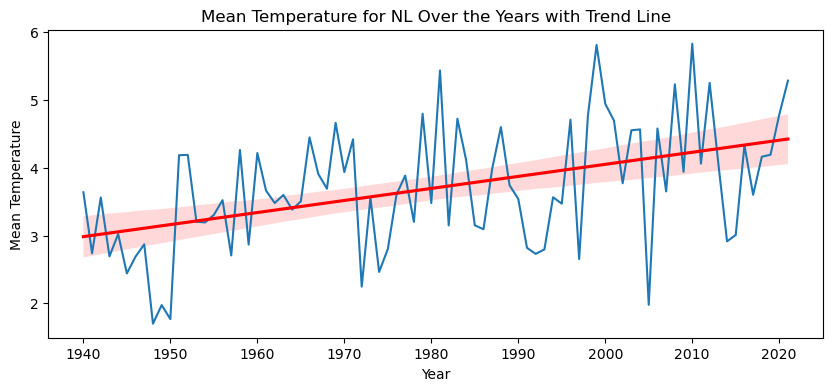

In [63]:
# Creating province/teritory list
prov_list = ['BC', 'YT', 'NT', 'NU', 'AB', 'SK', 'MB', 'ON', 'QC', 'NB', 'NS','PE', 'NL']

# Starting for loop to go through each individual province
for prov in prov_list:
    # Calculating mean temperature by year for each province/teritory
    info_to_plot = df_weather[df_weather['Prov_or_Ter'] == prov].groupby([df_weather['Date'].dt.year])['Tm'].mean()
    
    # Plotting mean temperature for province/teritory with a trend line
    plt.figure(figsize=(10, 4))
    sns.lineplot(data=info_to_plot, x='Date', y=info_to_plot.values)
    # Creating trendline
    sns.regplot(data=info_to_plot.reset_index(), x='Date', y='Tm', scatter=False, color='red')
    plt.xlabel('Year')
    plt.ylabel('Mean Temperature')
    plt.title(f"Mean Temperature for {prov} Over the Years with Trend Line")
    plt.show()

Observations from `Tm`charts:
1. The mean temperature for BC, YT, and PE has been steadily increasing over time.
2. The mean temperature for NT, AB, ON, and NS have a steeper increased trend line.
3. NU, SK, NB have maintained a steady mean temperatures.
4. MB is the only province with a decline in mean temperature.
5. QC has an anomaly in its temperature data around the late 2010s. There was a sudden dip in mean temperature. More research is required as the cause of this anomaly.
6. Although mean temperatures go up and down, there are noticable peaks and valleys in the recent decades (see QC, NS, SK, and YT). It seems like the year over year differences in mean temperature are getting larger. 

`Tx`: Highest monthly maximum temperature <br>
`Tn`: Lowest monthly minimum temperature

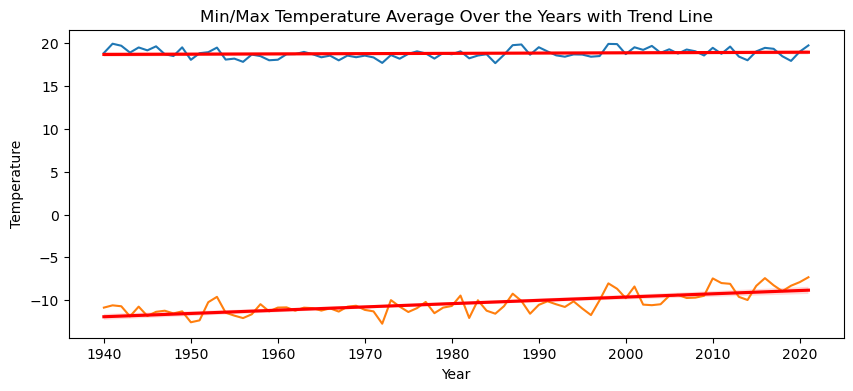

In [64]:
# Creating groupbys for Tx and Tn by averaging them by year
tx_groupby = df_weather.groupby([df_weather['Date'].dt.year])['Tx'].mean()
tn_groupby = df_weather.groupby([df_weather['Date'].dt.year])['Tn'].mean()

# Plotting Tx and Tn
plt.figure(figsize=(10, 4))
sns.lineplot(data=tx_groupby, x='Date', y=tx_groupby.values)
sns.lineplot(data=tn_groupby, x='Date', y=tn_groupby.values)
# Creating trendline
sns.regplot(data=tx_groupby.reset_index(), x='Date', y='Tx', scatter=False, color='red')
sns.regplot(data=tn_groupby.reset_index(), x='Date', y='Tn', scatter=False, color='red')
plt.xlabel('Year')
plt.ylabel('Temperature')
plt.title(f"Min/Max Temperature Average Over the Years with Trend Line")
plt.show()

Observations from `Tx` and `Tn` chart:
1. Although the highest maximum temperature (blue line) goes up and down every year, there is no noticable difference in the trend line. The average of the highest maximum monthly temperatures have remained quite steady over the years.
2. The average of the lowest minimum temperature (orange line) though has inceased throughout the years. There is a noticable upward trend for the lowest minimum temperature. Since 1940, the minimum monthly temperatures are warmer than before.
3. Although the maximum temperature hasn't changed that much, the higher average temperature seems to be caused by an increase in the minimum temperatures. 

`S`: Snowfall

<Figure size 1000x1000 with 0 Axes>

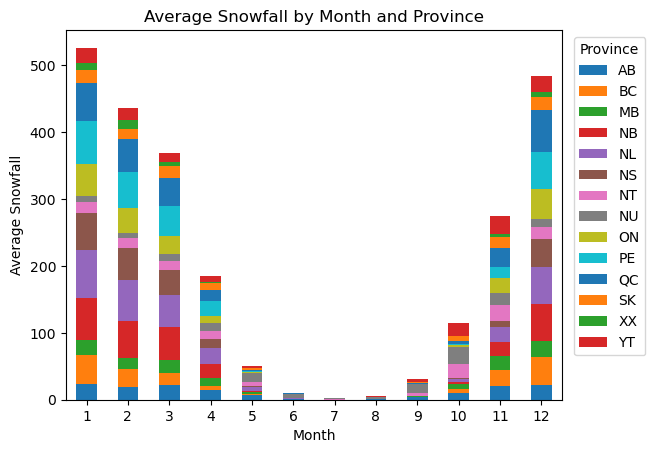

In [65]:
# Grouping by month, province, and year and calculating mean S
s_grouped = df_weather.groupby([df_weather['Date'].dt.month, 'Prov_or_Ter'])['S'].mean().reset_index()

# Pivot the data for stacked bar plot
s_pivot = s_grouped.pivot(index='Date', columns='Prov_or_Ter', values='S')

# Plotting stacked bar plot
plt.figure(figsize=(10, 10))
s_pivot.plot(kind='bar', stacked=True)
plt.xlabel('Month')
plt.ylabel('Average Snowfall')
plt.title("Average Snowfall by Month and Province")
plt.legend(title='Province', bbox_to_anchor=(1.01, 1), loc='upper left')
plt.xticks(rotation=0)
plt.show()


Observations from `S` chart:
1. The amount of snowfall follows the winter season. It starts building in October and peaking in January. 
2. Among the teritories, it seems like Yukon has the highest average snowfall. Nunavut and Nortwestern teritories aren't as high up in the list even though they are very close to the arctic circle. 

`P`: Precipitation

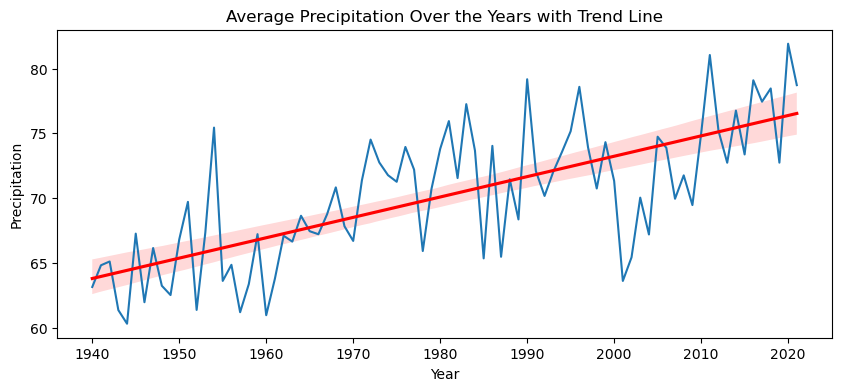

In [66]:
# Creating groupbys for P by averaging them by year
p_groupby = df_weather.groupby([df_weather['Date'].dt.year])['P'].mean()

# Plotting P
plt.figure(figsize=(10, 4))
sns.lineplot(data=p_groupby, x='Date', y=p_groupby.values)
# Creating trendline
sns.regplot(data=p_groupby.reset_index(), x='Date', y='P', scatter=False, color='red')
plt.xlabel('Year')
plt.ylabel('Precipitation')
plt.title("Average Precipitation Over the Years with Trend Line")
plt.show()

Observations from `P` chart:
1. Average precipitation has been increasing throughout the years.
2. The difference between the peaks and valleys are getting larger. There is a big difference from the mid 1990s to the early 2000s. There is a larger difference from the early 2000s to early 2010s. 
3. Although El Nino and La Nina periods are a natural phenomenon, there seem to be bigger dips in the average precipitation. 

`HDD`: Degree days below 18c
`CDD`: Degree days above 18c

In [67]:
# Looking at value counts
print(df_weather['HDD'].value_counts())
print(df_weather['CDD'].value_counts())

0.0       1894
0.5        424
0.2        412
1.0        386
1.2        333
          ... 
1507.7       1
1784.6       1
1610.5       1
1677.1       1
1716.2       1
Name: HDD, Length: 16503, dtype: int64
0.0      804234
0.5        6236
0.3        5839
1.5        5835
1.0        5509
          ...  
208.3         1
185.0         1
203.6         1
203.4         1
170.2         1
Name: CDD, Length: 2053, dtype: int64


There are 16,503 unique values for HDD and 2,053 unique values for CDD. Since the information is quite confusing, additional research was required. 

Degree days below 18°C (also known as heating degree days) is a concept used in meteorology and energy management to quantify the amount of heating required in a building or region during a specific time period. It's a way to measure how cold the weather is and how much energy is needed to maintain a comfortable indoor temperature.

Degree days above 18°C (also known as cooling degree days) is a concept similar to degree days below 18°C, but it's used to quantify the amount of cooling required in a building or region during warm weather. It's a way to measure how hot the weather is and how much energy is needed to maintain a comfortable indoor temperature by using air conditioning or cooling systems.

Since we already have the mean temperatures and we are not concerned with energy mangement in heating/cooling buildings, we will drop these columns.

In [68]:
# Dropping HDD and CDD
df_weather.drop(columns=['HDD', 'CDD'], inplace=True)

## Combining Datasets <a id="2.3"></a>

Before we continue with our analysis, we have to combine both our weather and fire datasets. We do not have a unique identifer that would allow us to combine them easily. In order to have as accurate information as possible, we have to match the closest weather station to the fire. Another challenge is matching the dates. The weather data only has monthly information while the fire data has specific dates. We will address these issues individually before combining our datasets.

In [69]:
# Creating a new column in fire dataset that will match the monthly data from the weather dataset
df_fire['date_to_match'] = df_fire['YEAR'].astype(str) + '-' + df_fire['MONTH'].astype(str) + '-1'
df_fire['date_to_match'] = pd.to_datetime(df_fire['date_to_match'])

# Sanity check
df_fire.head()

,SRC_AGENCY,FIRE_ID,FIRENAME,LATITUDE,LONGITUDE,YEAR,MONTH,DAY,REP_DATE,DECADE,SIZE_HA,CAUSE,MORE_INFO,CFS_REF_ID,CFS_NOTE1,CFS_NOTE2,ECOZONE,ECOZ_NAME,date_to_match
FID,,,,,,,,,,,,,,,,,,,
0,BC,1953-G00041,,59.963,-128.172,1953,5,26,1953-05-26,1950-1959,8.0,H,,BC-1953-1953-G00041,,,12,Boreal Cordillera,1953-05-01
1,BC,1950-R00028,,59.318,-132.172,1950,6,22,1950-06-22,1950-1959,8.0,L,,BC-1950-1950-R00028,,,12,Boreal Cordillera,1950-06-01
2,BC,1950-G00026,,59.876,-131.922,1950,6,4,1950-06-04,1950-1959,12949.9,H,,BC-1950-1950-G00026,,,12,Boreal Cordillera,1950-06-01
3,BC,1951-R00097,,59.760,-132.808,1951,7,15,1951-07-15,1950-1959,241.1,H,,BC-1951-1951-R00097,,,12,Boreal Cordillera,1951-07-01
4,BC,1952-G00116,,59.434,-126.172,1952,6,12,1952-06-12,1950-1959,1.2,H,,BC-1952-1952-G00116,,,12,Boreal Cordillera,1952-06-01


We now have a new column that tells us the month and year of the fire occurance. It is also formated the same way as the `Date` column in the weather data. This should allow us to match the information.

We will now look at finding the closest weather station available to the fire occurance to get as accurate information as possible. Luckily, both datasets have longitude and latitude coordinates for us to use.

In [70]:
# Defining Euclidean distance to calculate cloest point between longitude and latitude
def dist(lat1, long1, lat2, long2):
    '''
    The function takes in 2 pairs of longitude and latitudes and calculates the 
    distance between the points.
    '''
    return math.sqrt((lat1 - lat2)**2 + (long1 - long2)**2)

# Defining function to look for the row in weather data that matches the fire occurance
def find_row(match_date, lat, long, weather_df):
    '''
    This function takes three 4 inputs. It looks at the date to match, the latitude
    and longitude to calculate, and the dataframe
    '''
    # Filters weather data for the specified match_date
    # Extracts all occurances in weather data that has the same date
    matched_date_df = df_weather[df_weather['Date'] == match_date]
    
    # Calculate distances to all stations from the matched_date_df
    # Creates a list of all distances
    distances = matched_date_df.apply(
        lambda row: dist(lat, long, row['Lat'], row['Long']),
        axis=1
    )
    
    # Find the index of the closest station for the matched date
    closest_station_index = distances.idxmin()
    
    # Get the closest station's details
    closest_station = matched_date_df.loc[closest_station_index, 'Stn_Name']
    
    # Filter for rows with the closest station and matching date
    matched_rows = matched_date_df[
        (matched_date_df['Stn_Name'] == closest_station) &
        (matched_date_df['Date'] == match_date)
    ]

  # Return the first row from the matched rows and returns none if there is nothing to match
    if not matched_rows.empty:
        return matched_rows.iloc[0]
    else:
        return None  # No matching row found

def extract_matched_results(fire_data, weather_data):
    
    '''
    This function takes 2 inputs, it will need the fire data set and the weather dataset.
    '''
    
    # Creating empty list 
    matched_rows_list = []
    
    # Loops through every row in fire data set and applies the find_row function
    for index, row in fire_data.iterrows():
        matched_rows = find_row(row['date_to_match'], row['LATITUDE'], row['LONGITUDE'], weather_data)
        matched_rows_list.append(matched_rows)
    
    # Concatenate the list of matched rows into a single DataFrame
    final_matched_df = pd.concat(matched_rows_list, ignore_index=True)
 
    return final_matched_df

Now that we have defined our functions, we will quickly reset the indexes of the fire data to avoid errors when combining the dataframes later on. 

In [71]:
# Resetting index for fire data
df_fire = df_fire.reset_index()

In [72]:
# Using extract_matched_results function 
final_matched_results = extract_matched_results(df_fire, df_weather)
final_matched_results

0          1953-05-01 00:00:00
1                     -128.822
2                       60.117
3                WATSON LAKE A
4                           YT
                  ...         
6161195                    0.0
6161196                    1.0
6161197                   43.8
6161198                    1.0
6161199                    7.0
Length: 6161200, dtype: object

In [73]:
# Checking our shape
final_matched_results.shape

(6161200,)

The shaped of our matched dataset does not match the same number of columns as our weather dataset. We will look at the shapes of the weather and fire data to gain some insight.

In [74]:
# Printing shapes
print(f"The shape of our weather data is {df_weather.shape}")
print(f"The shape of our fire data is {df_fire.shape}")
print(f"The shape of our final matched results is {final_matched_results.shape}")

The shape of our weather data is (1209878, 16)
The shape of our fire data is (385075, 20)
The shape of our final matched results is (6161200,)


It seems like the function put all the information into individual rows. The number of rows in our final matched results is equal to the number of fire occurances multiplied by the number of weather columns. We will reshape our data so that it is ready to be used.

In [75]:
# Reshaping results from function
reshaped = final_matched_results.values.reshape(385075,16)

reshaped_df = pd.DataFrame(reshaped, columns=[ 'Date', 'Long', 'Lat', 'Stn_Name', 
                                              'Prov_or_Ter', 'Tm', 'DwTm', 'Tx', 
                                              'DwTx', 'Tn', 'DwTn', 'S', 'DwS', 'P', 
                                              'DwP', 'Pd'])  

# Sanity check
reshaped_df

,Date,Long,Lat,Stn_Name,Prov_or_Ter,Tm,DwTm,Tx,DwTx,Tn,DwTn,S,DwS,P,DwP,Pd
0,1953-05-01,-128.822,60.117,WATSON LAKE A,YT,9.8,0.0,26.7,0.0,-3.3,0.0,2.5,0.0,33.0,0.0,8.0
1,1950-06-01,-132.743,60.173,TESLIN A,YT,13.6,0.0,31.7,0.0,-1.7,0.0,0.0,0.0,32.5,0.0,5.0
2,1950-06-01,-132.743,60.173,TESLIN A,YT,13.6,0.0,31.7,0.0,-1.7,0.0,0.0,0.0,32.5,0.0,5.0
3,1951-07-01,-132.743,60.173,TESLIN A,YT,15.9,0.0,31.1,0.0,2.8,0.0,0.0,0.0,34.6,0.0,7.0
4,1952-06-01,-126.433,59.9,SMITH RIVER A,BC,10.7,0.0,23.9,0.0,-2.2,0.0,0.0,0.0,93.5,0.0,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
385070,2021-07-01,-111.962,60.02,FORT SMITH A,NT,17.1,2.0,31.9,2.0,3.4,2.0,0.0,0.0,59.1,0.0,9.0
385071,2021-03-01,-115.073,49.489,FERNIE,BC,2.5,4.0,16.0,4.0,-15.0,4.0,51.8,4.0,65.9,4.0,7.0
385072,2021-03-01,-115.073,49.489,FERNIE,BC,2.5,4.0,16.0,4.0,-15.0,4.0,51.8,4.0,65.9,4.0,7.0
385073,2021-09-01,-115.073,49.489,FERNIE,BC,13.2,13.0,28.0,10.0,-2.0,13.0,0.0,10.0,42.6,10.0,5.0


Our reshaped data is now in the correct format. We can now concatenate our reshaped data to our weather df to create our final dataframe. 

In [76]:
# Concatenating fire data with extracted data
df = pd.concat([df_fire, reshaped_df], axis=1)

# Sanity check
df.head()

,FID,SRC_AGENCY,FIRE_ID,FIRENAME,LATITUDE,LONGITUDE,YEAR,MONTH,DAY,REP_DATE,...,DwTm,Tx,DwTx,Tn,DwTn,S,DwS,P,DwP,Pd
0,0,BC,1953-G00041,,59.963,-128.172,1953,5,26,1953-05-26,...,0.0,26.7,0.0,-3.3,0.0,2.5,0.0,33.0,0.0,8.0
1,1,BC,1950-R00028,,59.318,-132.172,1950,6,22,1950-06-22,...,0.0,31.7,0.0,-1.7,0.0,0.0,0.0,32.5,0.0,5.0
2,2,BC,1950-G00026,,59.876,-131.922,1950,6,4,1950-06-04,...,0.0,31.7,0.0,-1.7,0.0,0.0,0.0,32.5,0.0,5.0
3,3,BC,1951-R00097,,59.760,-132.808,1951,7,15,1951-07-15,...,0.0,31.1,0.0,2.8,0.0,0.0,0.0,34.6,0.0,7.0
4,4,BC,1952-G00116,,59.434,-126.172,1952,6,12,1952-06-12,...,0.0,23.9,0.0,-2.2,0.0,0.0,0.0,93.5,0.0,11.0


We have created a duplicate index column as our `FID` was our index column set for our fire data. We will reset the index and save the final data into a csv because our extraction function takes too long to rerun.

In [77]:
# Resetting index to `FID` again
df = df.set_index('FID')

# Saving the final dataset into a csv
df.to_csv('final_capstone_data.csv')

In [78]:
df = pd.read_csv('Data/final_capstone_data.csv', index_col='FID')

## Feature Engineering <a id="2.4"></a>

Now that we have combined our dataset, we can look at creating more features to help us predict our target variable. Based on research, wildland fires need oxygen, fuel, and heat. We will attempt to use the data available to look into these factors and hopefully create meaningful features. 

source: https://www2.gov.bc.ca/gov/content/safety/wildfire-status/wildfire-response/about-wildfire

`Date`

Before proceeding with feature engineering, we will first fix the fire occurance date. Right now, it is split in separate `YEAR`, `MONTH`, and `DAY` columns. To be more useful, we will combine them and change them to a datetime format.

In [79]:
# Creating new column from a combination of `YEAR`, `MONTH`, and `DATE`
df['FIRE_DATE'] = pd.to_datetime(df['YEAR'].astype(str) + '-' + df['MONTH'].astype(str) + '-' + df['DAY'].astype(str))

# Sanity check
df['FIRE_DATE'].head()

FID
0   1953-05-26
1   1950-06-22
2   1950-06-04
3   1951-07-15
4   1952-06-12
Name: FIRE_DATE, dtype: datetime64[ns]

### Possible fuel sources

Fuel sources can come in the form of multiple sources. They could be dead vegetation, trees, and other organic flamable materials. The type and amount of fuel plays a big factor in the rate of spread for wildland fires. Fires can die out if they have no more fuel to consume. Once an area has been consumed by wildfire, it does take time for trees to grow back, dead leaves/twigs to pile up, and organic material to build up. The differences in ecological zones also play a big part of regrowth after wildland fires due to the difference in flora found in each zone. We might have to create different time buckets to account for different zones. We will look into the proximity of wildland fire occurances as well to each other and the time difference as well. 

source:https://www2.gov.bc.ca/gov/content/safety/wildfire-status/wildfire-response/about-wildfire#fuel
source:https://www.fs.usda.gov/database/feis/fire_regimes/PlainsGrass_Prairie/all.html#IgnitionSeasonFrequency

In [80]:
# Creating empty list
num_fires1 = []

# Looping through all rows to find fires within a certain range and date
# Fires within 1 degree change and within 1 year
for index, row in df.iterrows():
    # Creating dateoffset to look at
    n_date = row['FIRE_DATE'] - pd.DateOffset(years=1)
    
    # Creating Long and Lat offset to look at
    long_add = row['LONGITUDE'] + 1
    long_sub = row['LONGITUDE'] - 1
    lat_add = row['LATITUDE'] + 1
    lat_sub = row['LATITUDE'] - 1
    
    # Creating mask to look for specific dates 
    date_space_mask = (df['FIRE_DATE'] < row['FIRE_DATE']) & (df['FIRE_DATE'] > n_date) & (df['LONGITUDE'] < long_add) & (df['LATITUDE'] < lat_add) & (df['LONGITUDE'] > long_sub) & (df['LATITUDE'] > lat_sub)   
    
    # Creating filtered dataframe of specific dates
    filtered_rows = df[date_space_mask]
    
    # Appending count to list
    num_fires1.append(filtered_rows.shape[0])
 
# Creating new variable 
df['fcount_1yr_1diff'] = num_fires1

In [81]:
# Creating empty list
# Fires within 1 degree change and in between 1 - 5 years
num_fires2 = []

# Looping through all rows to find fires within a certain range and date
for index, row in df.iterrows():
    # Creating dateoffset to look at
    n_date_1 = row['FIRE_DATE'] - pd.DateOffset(years=1)
    n_date_5 = row['FIRE_DATE'] - pd.DateOffset(years=5)
    
    # Creating Long and Lat offset to look at
    long_add = row['LONGITUDE'] + 1
    long_sub = row['LONGITUDE'] - 1
    lat_add = row['LATITUDE'] + 1
    lat_sub = row['LATITUDE'] - 1
    
    # Creating mask to look for specific dates 
    date_space_mask = (df['FIRE_DATE'] < n_date_1) & (df['FIRE_DATE'] > n_date_5) & (df['LONGITUDE'] < long_add) & (df['LATITUDE'] < lat_add) & (df['LONGITUDE'] > long_sub) & (df['LATITUDE'] > lat_sub)   
    
    # Creating filtered dataframe of specific dates
    filtered_rows = df[date_space_mask]
    
    # Appending count to list
    num_fires2.append(filtered_rows.shape[0])

# Creating new variable 
df['fcount_1to5yr_1diff'] = num_fires2

In [82]:
# Creating empty list
# Fires within 1 degree change and in between 5 - 15 years
num_fires3 = []

# Looping through all rows to find fires within a certain range and date
for index, row in df.iterrows():
    # Creating dateoffset to look at
    n_date_5 = row['FIRE_DATE'] - pd.DateOffset(years=5)
    n_date_15 = row['FIRE_DATE'] - pd.DateOffset(years=15)
    
    # Creating Long and Lat offset to look at
    long_add = row['LONGITUDE'] + 1
    long_sub = row['LONGITUDE'] - 1
    lat_add = row['LATITUDE'] + 1
    lat_sub = row['LATITUDE'] - 1
    
    # Creating mask to look for specific dates 
    date_space_mask = (df['FIRE_DATE'] < n_date_5) & (df['FIRE_DATE'] > n_date_15) & (df['LONGITUDE'] < long_add) & (df['LATITUDE'] < lat_add) & (df['LONGITUDE'] > long_sub) & (df['LATITUDE'] > lat_sub)   
    
    # Creating filtered dataframe of specific dates
    filtered_rows = df[date_space_mask]
    
    # Appending count to list
    num_fires3.append(filtered_rows.shape[0])
 
# Creating new variable 
df['fcount_5to15yr_1diff'] = num_fires3

In [83]:
# Creating empty list
# Fires within 1 degree change and in between 15 - 45 years
num_fires4 = []

# Looping through all rows to find fires within a certain range and date
for index, row in df.iterrows():
    # Creating dateoffset to look at
    n_date_15 = row['FIRE_DATE'] - pd.DateOffset(years=15)
    n_date_45 = row['FIRE_DATE'] - pd.DateOffset(years=45)
    
    # Creating Long and Lat offset to look at
    long_add = row['LONGITUDE'] + 1
    long_sub = row['LONGITUDE'] - 1
    lat_add = row['LATITUDE'] + 1
    lat_sub = row['LATITUDE'] - 1
    
    # Creating mask to look for specific dates 
    date_space_mask = (df['FIRE_DATE'] < n_date_15) & (df['FIRE_DATE'] > n_date_45) & (df['LONGITUDE'] < long_add) & (df['LATITUDE'] < lat_add) & (df['LONGITUDE'] > long_sub) & (df['LATITUDE'] > lat_sub)   
    
    # Creating filtered dataframe of specific dates
    filtered_rows = df[date_space_mask]
    
    # Appending count to list
    num_fires4.append(filtered_rows.shape[0])
 
# Creating new variable 
df['fcount_15to45yr_1diff'] = num_fires4

In [84]:
# Creating empty list
# Fires between 1 and 3 degree change and under 1 year
num_fires5 = []

# Looping through all rows to find fires within a certain range and date
for index, row in df.iterrows():
    # Creating dateoffset to look at
    n_date = row['FIRE_DATE'] - pd.DateOffset(years=1)
    
    # Creating Long and Lat offset to look at
    long_add = row['LONGITUDE'] + 3
    long_sub = row['LONGITUDE'] - 3
    lat_add = row['LATITUDE'] + 3
    lat_sub = row['LATITUDE'] - 3
    long_add_1 = row['LONGITUDE'] + 1
    long_sub_1 = row['LONGITUDE'] - 1
    lat_add_1 = row['LATITUDE'] + 1
    lat_sub_1 = row['LATITUDE'] - 1
    
    # Creating mask to look for specific dates 
    date_space_mask = (df['FIRE_DATE'] < row['FIRE_DATE']) & (df['FIRE_DATE'] > n_date) & (df['LONGITUDE'] < long_add) & (df['LONGITUDE'] > long_add_1) & (df['LATITUDE'] < lat_add) & (df['LATITUDE'] > lat_add_1)& (df['LONGITUDE'] > long_sub) & (df['LONGITUDE'] < long_sub_1)& (df['LATITUDE'] > lat_sub) & (df['LATITUDE'] < lat_sub_1)   
    
    # Creating filtered dataframe of specific dates
    filtered_rows = df[date_space_mask]
    
    # Appending count to list
    num_fires5.append(filtered_rows.shape[0])
 
# Creating new variable 
df['fcount_1yr_1to3diff'] = num_fires5

In [85]:
# Creating empty list
# Fires between 1 and 3 degree change and between 1 and 5 years
num_fires6 = []

# Looping through all rows to find fires within a certain range and date
for index, row in df.iterrows():
    # Creating dateoffset to look at
    n_date_1 = row['FIRE_DATE'] - pd.DateOffset(years=1)
    n_date_5 = row['FIRE_DATE'] - pd.DateOffset(years=5)
    
    # Creating Long and Lat offset to look at
    long_add = row['LONGITUDE'] + 3
    long_sub = row['LONGITUDE'] - 3
    lat_add = row['LATITUDE'] + 3
    lat_sub = row['LATITUDE'] - 3
    long_add_1 = row['LONGITUDE'] + 1
    long_sub_1 = row['LONGITUDE'] - 1
    lat_add_1 = row['LATITUDE'] + 1
    lat_sub_1 = row['LATITUDE'] - 1
    
    # Creating mask to look for specific dates 
    date_space_mask = (df['FIRE_DATE'] < n_date_1) & (df['FIRE_DATE'] > n_date_5) & (df['LONGITUDE'] < long_add) & (df['LONGITUDE'] > long_add_1) & (df['LATITUDE'] < lat_add) & (df['LATITUDE'] > lat_add_1)& (df['LONGITUDE'] > long_sub) & (df['LONGITUDE'] < long_sub_1)& (df['LATITUDE'] > lat_sub) & (df['LATITUDE'] < lat_sub_1) 
    
    # Creating filtered dataframe of specific dates
    filtered_rows = df[date_space_mask]
    
    # Appending count to list
    num_fires6.append(filtered_rows.shape[0])
 
# Creating new variable 
df['fcount_1to5yr_1to3diff'] = num_fires6

In [86]:
# Creating empty list
# Fires between 1 and 3 degree change and between 5 and 15 years
num_fires7 = []

# Looping through all rows to find fires within a certain range and date
for index, row in df.iterrows():
    # Creating dateoffset to look at
    n_date_5 = row['FIRE_DATE'] - pd.DateOffset(years=5)
    n_date_15 = row['FIRE_DATE'] - pd.DateOffset(years=15)
    
    # Creating Long and Lat offset to look at
    long_add = row['LONGITUDE'] + 3
    long_sub = row['LONGITUDE'] - 3
    lat_add = row['LATITUDE'] + 3
    lat_sub = row['LATITUDE'] - 3
    long_add_1 = row['LONGITUDE'] + 1
    long_sub_1 = row['LONGITUDE'] - 1
    lat_add_1 = row['LATITUDE'] + 1
    lat_sub_1 = row['LATITUDE'] - 1
    
    # Creating mask to look for specific dates 
    date_space_mask = (df['FIRE_DATE'] < n_date_5) & (df['FIRE_DATE'] > n_date_15) & (df['LONGITUDE'] < long_add) & (df['LONGITUDE'] > long_add_1) & (df['LATITUDE'] < lat_add) & (df['LATITUDE'] > lat_add_1)& (df['LONGITUDE'] > long_sub) & (df['LONGITUDE'] < long_sub_1)& (df['LATITUDE'] > lat_sub) & (df['LATITUDE'] < lat_sub_1) 
    
    # Creating filtered dataframe of specific dates
    filtered_rows = df[date_space_mask]
    
    # Appending count to list
    num_fires7.append(filtered_rows.shape[0])
 
# Creating new variable 
df['fcount_5to15yr_1to3diff'] = num_fires7

In [87]:
# Creating empty list
# Fires between 1 and 3 degree change and between 15 and 45 years
num_fires8 = []

# Looping through all rows to find fires within a certain range and date
for index, row in df.iterrows():
    # Creating dateoffset to look at
    n_date_15 = row['FIRE_DATE'] - pd.DateOffset(years=15)
    n_date_45 = row['FIRE_DATE'] - pd.DateOffset(years=45)
    
    # Creating Long and Lat offset to look at
    long_add = row['LONGITUDE'] + 3
    long_sub = row['LONGITUDE'] - 3
    lat_add = row['LATITUDE'] + 3
    lat_sub = row['LATITUDE'] - 3
    long_add_1 = row['LONGITUDE'] + 1
    long_sub_1 = row['LONGITUDE'] - 1
    lat_add_1 = row['LATITUDE'] + 1
    lat_sub_1 = row['LATITUDE'] - 1
    
    # Creating mask to look for specific dates 
    date_space_mask = (df['FIRE_DATE'] < n_date_15) & (df['FIRE_DATE'] > n_date_45) & (df['LONGITUDE'] < long_add) & (df['LONGITUDE'] > long_add_1)& (df['LATITUDE'] < lat_add) & (df['LATITUDE'] > lat_add_1)& (df['LONGITUDE'] > long_sub) & (df['LONGITUDE'] < long_sub_1)& (df['LATITUDE'] > lat_sub) & (df['LATITUDE'] < lat_sub_1) 
    
    # Creating filtered dataframe of specific dates
    filtered_rows = df[date_space_mask]
    
    # Appending count to list
    num_fires8.append(filtered_rows.shape[0])
 
# Creating new variable 
df['fcount_15to45yr_1to3diff'] = num_fires8

## Bivariate Analysis <a id="2.5"></a>

`ECOZ_NAME`: Ecological Zone Name

<Figure size 1500x1500 with 0 Axes>

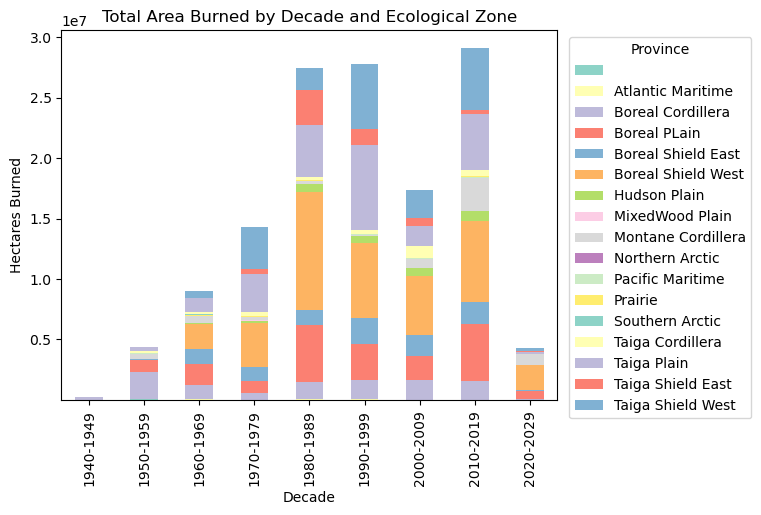

In [90]:
# Summing `SIZE_HA` by `ECOZ_NAME`
ecoz_grouped = df.groupby(['ECOZ_NAME', 'DECADE'])['SIZE_HA'].sum()

# Pivot the data for stacked bar plot
ecoz_grouped = ecoz_grouped.reset_index()
ecoz_pivot = ecoz_grouped.pivot(index='DECADE', columns='ECOZ_NAME', values='SIZE_HA')

# Define custom colors for the stacked bars
custom_colors = sns.color_palette("Set3", n_colors=len(ecoz_pivot.columns))

# Plotting stacked bar plot with custom colors
plt.figure(figsize=(15, 15))
ecoz_pivot.plot(kind='bar', stacked=True, color=custom_colors)
plt.xlabel('Decade')
plt.ylabel('Hectares Burned')
plt.title("Total Area Burned by Decade and Ecological Zone")
plt.legend(title='Province', bbox_to_anchor=(1.01, 1), loc='upper left')
plt.xticks(rotation=90)
plt.show()

Observations from total area burned by ecological zone:
1. The Tiaga Plain, Boreal Shield West, Boreal Shield East and  seems to be consistently in the top. 
2. There is an imbalance of proportions for area burned. Some ecological zones are really more affected in severity of wildland fires.
3. It is a bit hard to read the colors due to the number of ecological zones. We will print the actual numbers to gain more insight.

In [91]:
# Looking at actual values
ecoz_pivot

ECOZ_NAME,,Atlantic Maritime,Boreal Cordillera,Boreal PLain,Boreal Shield East,Boreal Shield West,Hudson Plain,MixedWood Plain,Montane Cordillera,Northern Arctic,Pacific Maritime,Prairie,Southern Arctic,Taiga Cordillera,Taiga Plain,Taiga Shield East,Taiga Shield West
DECADE,,,,,,,,,,,,,,,,,
1940-1949,NaN,NaN,77294.050,3.002600e+03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.000000,NaN,NaN,1.222030e+05,NaN,NaN
1950-1959,45863.6010,23734.010000,2231852.204,1.012704e+06,3.496400e+04,1.462250e+04,NaN,NaN,3.943691e+05,NaN,125447.100,0.400000,NaN,136477.190,3.490939e+05,NaN,2.170000e+03
1960-1969,6.3000,40434.440000,1175218.428,1.730706e+06,1.249738e+06,2.059859e+06,131234.600000,6008.160000,5.279535e+05,NaN,49460.100,76190.884051,38063.67,180996.360,1.125446e+06,6.579984e+04,5.377735e+05
1970-1979,6.5000,3982.900000,541879.043,1.004321e+06,1.141669e+06,3.701998e+06,173151.100004,1773.600002,2.531543e+05,9.41,32920.400,50011.118743,16087.27,360580.770,3.106039e+06,4.570447e+05,3.478076e+06
1980-1989,3064.5000,55505.950000,1439777.296,4.708644e+06,1.242483e+06,9.721494e+06,672776.900002,2949.300006,2.395336e+05,3.50,23674.100,91877.784284,14267.67,190689.760,4.367317e+06,2.880429e+06,1.807962e+06
1990-1999,66.3000,61386.630000,1545454.890,3.033611e+06,2.132572e+06,6.239079e+06,539958.800000,1836.200004,1.289323e+05,NaN,17139.738,6668.480000,5903.27,306967.740,7.064991e+06,1.331692e+06,5.373734e+06
2000-2009,35.2470,14525.666000,1592767.965,1.990318e+06,1.742852e+06,4.885829e+06,684442.911000,1017.083600,7.835907e+05,NaN,14794.363,68790.699000,2400.64,916610.250,1.670982e+06,7.107888e+05,2.317183e+06
2010-2019,3980.1064,7630.771600,1513870.737,4.790307e+06,1.796202e+06,6.702291e+06,804946.400000,797.898399,2.726914e+06,NaN,130841.113,14524.534400,17170.40,510131.558,4.612716e+06,3.342642e+05,5.166967e+06
2020-2029,692.1522,2741.810724,43352.766,6.635626e+05,6.441284e+04,2.105010e+06,31946.660285,556.330700,8.494810e+05,NaN,2799.985,18222.163433,25.78,4846.260,1.757680e+05,5.092150e+04,2.784408e+05


Observations from actual values:
1. Boreal Shield West consistently has a high number of hectares burned except for the decade of the 2020s. More research would be useful if anything was done differently to manage the area.
2. The Norther arcitc has very little wildland fire occurances. It has resulted in a lot of NaN values
3. There are a lot of NaN values for total hectares burned in the 1940s and some in the 1950s. This could be due to lack of records kept by the reporting agencies.
4. The Tiaga Shield East and Tiaga Shield West also have consistently high totals of area burned. 

<br>
We will have to binarize this column before proceeding with modeling.

`CAUSE`: Cause of fire

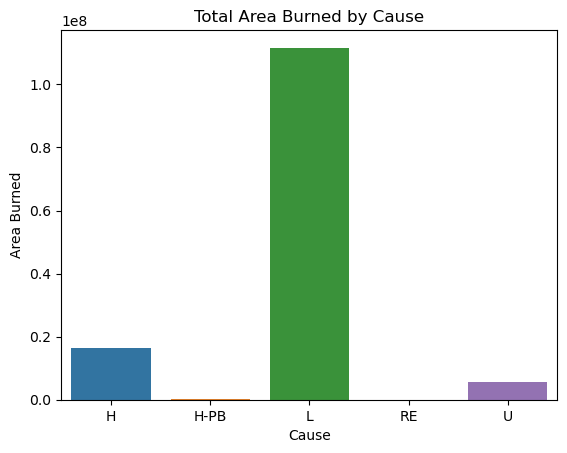

In [92]:
# Summing `SIZE_HA` by `CAUSE`
cause_grouped = df.groupby(['CAUSE'])['SIZE_HA'].sum()

# Plotting the data
sns.barplot(x=cause_grouped.index, y=cause_grouped.values)
plt.xlabel('Cause')
plt.ylabel('Area Burned')
plt.title('Total Area Burned by Cause')
plt.show()

Observation from `CAUSE` chart:
1. Lightning is the major cause for severity in wildfires. It is at least 5x larger in area burned than human caused wildland fires. 
2. Although humans is the leading cause of number of occurances based on earlier graphs, it does not even come close to the total area burned for lightning causes.

`Year`: Year of wildland fire occurance

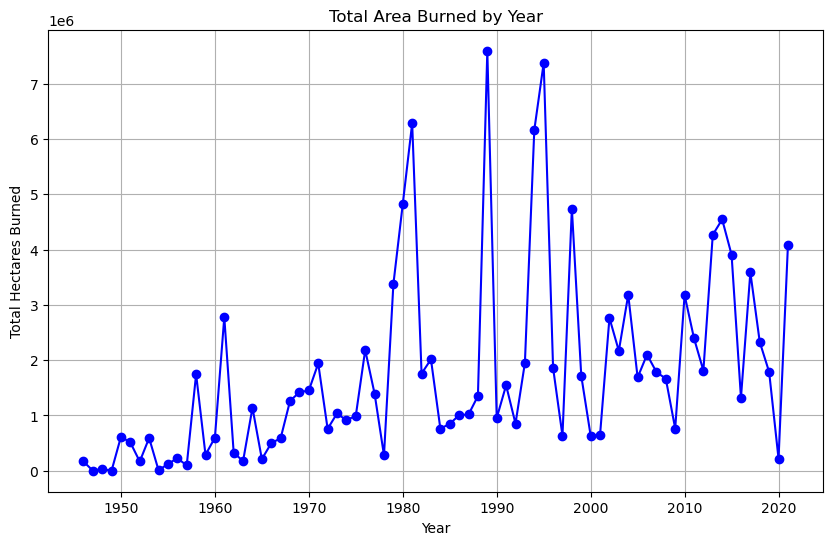

In [93]:
# Summing `SIZE_HA` by `YEAR`
cause_grouped = df.groupby(['YEAR'])['SIZE_HA'].sum()

# Plotting the data
plt.figure(figsize=(10, 6))
plt.plot(cause_grouped.index, cause_grouped.values, marker='o', linestyle='-', color='b')
plt.xlabel('Year')
plt.ylabel('Total Hectares Burned')
plt.title('Total Area Burned by Year')
plt.grid(True)
plt.show()

Observations from `YEAR` chart:
1. The peak in total hectares burned was in the late 1980s. 
2. There is still an upward trend from the 1970s to the 2010s.
3. Based on the history of forestry management in Canada, there seems to be a positive effect on the forestry act enacted in the late 1980s.

`SRC_AGENCY`

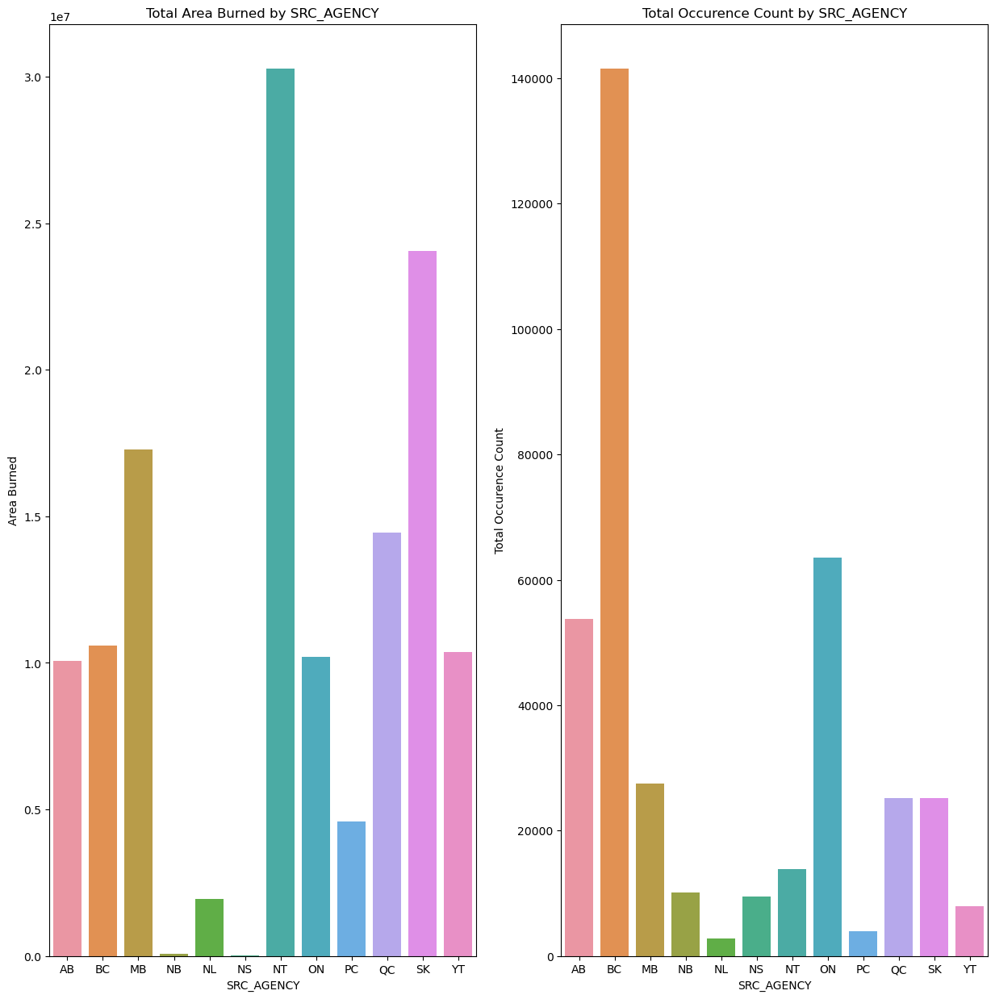

In [94]:
# Summing `SIZE_HA` by `SRC_AGENCY`
srca_grouped = df.groupby(['SRC_AGENCY'])['SIZE_HA'].sum()
# Countin occurances `SIZE_HA` by `SRC_AGENCY`
srca2_grouped = df.groupby(['SRC_AGENCY'])['SIZE_HA'].count()

# Creating subplots
plt.subplots(1,2, figsize=(15,15))

# Plotting first subplot
plt.subplot(1,2,1)
sns.barplot(x=srca_grouped.index, y=srca_grouped.values)
plt.xlabel('SRC_AGENCY')
plt.ylabel('Area Burned')
plt.title('Total Area Burned by SRC_AGENCY')

# Plotting second subplot
plt.subplot(1,2,2)
sns.barplot(x=srca2_grouped.index, y=srca2_grouped.values)
plt.xlabel('SRC_AGENCY')
plt.ylabel('Total Occurence Count')
plt.title('Total Occurence Count by SRC_AGENCY')

plt.show()

Observations from the `SRC_AGENCY` chart:
1. Northwestern teritories has the largest amount of area burned. It is followed by Saskatchewan and Manitoba. This is interesting since all 3 provinces either have average or below average number of occurances reported. This tells us that even though the number of occurances might be minimal, the severity of wildland fires in these provinces are worse than the rest of Canada.
2. British Columbia and Ontario are the top 2 in number of occurances but they are just average in area burned. 
3. Nova Scotia and New Burnswick have the lowest number of area burned and one of the lower counts of occurances. This could be because they are a lot smaller in size compared to the rest of the provinces or because of their geographic location near the Atlantic ocean. 

Further research is needed to see if the Northwestern Teritories and Saskatchewan have consistently high total area burned or if they are just due to outliers in the dataset. Based on our initial exploration of the `SIZE_HA` feature, we saw that most occurance were close to 1 hectare in damage but there were some occurances that had burned through massive areas. 

We will look at NT, SK, and MB specifically. These provinces do not have the highest number of occurances but have large areas burned. 

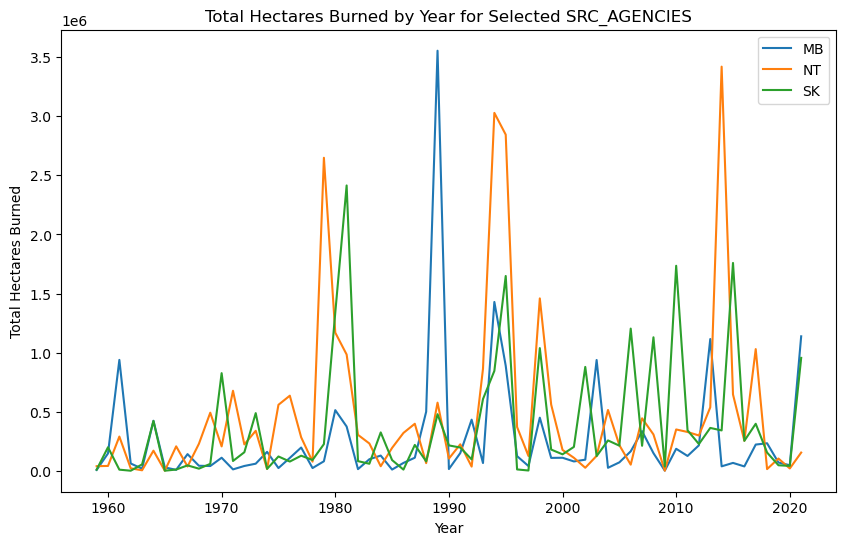

In [95]:
# Summing SIZE_HA by YEAR and SRC_AGENCY
agencies_to_filter = ['NT', 'SK', 'MB']
grouped = df[df['SRC_AGENCY'].isin(agencies_to_filter)].groupby(['YEAR', 'SRC_AGENCY'])['SIZE_HA'].sum()

# Create the line plot using Seaborn
plt.figure(figsize=(10, 6))
sns.lineplot(data=grouped, x='YEAR', y=grouped.values, hue='SRC_AGENCY')
plt.xlabel('Year')
plt.ylabel('Total Hectares Burned')
plt.title('Total Hectares Burned by Year for Selected SRC_AGENCIES')
plt.legend()
plt.show()

Observations from Northwestern Territories Total Hectares Burned by Year Chart:
1. NT has huge spikes in the area burned. It is not quite a consistent increase YoY but they have 3 specific years where the total area burned spikes.
2. MB has its largest spike in the late 1980s which is consistent with total burned area in Canada.
3. SK does not spike as high as MB and NT does but has consistently higher totals for area burned compared to the other 2 provinces.


## Correlation  <a id="2.6"></a>

We will now look at correlation between the features.

In [96]:
correlation_matrix = df.corr()
correlation_matrix

C:\Users\nicod\AppData\Local\Temp\ipykernel_24656\868109210.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



,LATITUDE,LONGITUDE,YEAR,MONTH,DAY,SIZE_HA,ECOZONE,Long,Lat,Tm,...,DwP,Pd,fcount_1yr_1diff,fcount_1to5yr_1diff,fcount_5to15yr_1diff,fcount_15to45yr_1diff,fcount_1yr_1to3diff,fcount_1to5yr_1to3diff,fcount_5to15yr_1to3diff,fcount_15to45yr_1to3diff
LATITUDE,1.000000,-0.588677,0.024159,0.033227,0.002988,0.070741,-0.031958,-0.578318,0.970310,-0.056980,...,0.054228,-0.079677,-0.329934,-0.337551,-0.295721,-0.168297,NaN,NaN,NaN,NaN
LONGITUDE,-0.588677,1.000000,0.210416,-0.153653,0.019072,-0.003943,-0.631111,0.995302,-0.591334,-0.052802,...,-0.029383,0.263934,-0.122737,-0.181996,-0.206637,-0.246021,NaN,NaN,NaN,NaN
YEAR,0.024159,0.210416,1.000000,-0.062462,0.011399,0.007211,-0.245501,0.210405,0.016083,-0.035923,...,0.212082,0.119299,-0.164681,-0.098259,0.100248,0.389969,NaN,NaN,NaN,NaN
MONTH,0.033227,-0.153653,-0.062462,1.000000,-0.179952,-0.007656,0.134057,-0.154106,0.034066,0.414233,...,-0.032412,0.005295,0.116539,0.094040,0.103045,0.113171,NaN,NaN,NaN,NaN
DAY,0.002988,0.019072,0.011399,-0.179952,1.000000,-0.001263,-0.029122,0.019155,0.001859,-0.057649,...,0.012036,-0.101267,-0.003494,-0.010162,-0.008748,-0.008319,NaN,NaN,NaN,NaN
SIZE_HA,0.070741,-0.003943,0.007211,-0.007656,-0.001263,1.000000,-0.039081,-0.003953,0.070405,0.010409,...,0.006921,-0.019932,-0.045637,-0.050868,-0.044554,-0.026921,NaN,NaN,NaN,NaN
ECOZONE,-0.031958,-0.631111,-0.245501,0.134057,-0.029122,-0.039081,1.000000,-0.629727,-0.030535,0.066224,...,-0.013544,-0.191941,0.346003,0.428801,0.433379,0.406995,NaN,NaN,NaN,NaN
Long,-0.578318,0.995302,0.210405,-0.154106,0.019155,-0.003953,-0.629727,1.000000,-0.592260,-0.053499,...,-0.030583,0.263883,-0.120317,-0.179757,-0.204582,-0.244721,NaN,NaN,NaN,NaN
Lat,0.970310,-0.591334,0.016083,0.034066,0.001859,0.070405,-0.030535,-0.592260,1.000000,-0.067690,...,0.050241,-0.080485,-0.332506,-0.339754,-0.298863,-0.170798,NaN,NaN,NaN,NaN
Tm,-0.056980,-0.052802,-0.035923,0.414233,-0.057649,0.010409,0.066224,-0.053499,-0.067690,1.000000,...,-0.061969,-0.029890,0.154768,0.136264,0.164413,0.153888,NaN,NaN,NaN,NaN


We have quite a few number of features and we are unable to see all the correlation numbers. We will plot it in a heatmap to give us easier visibility

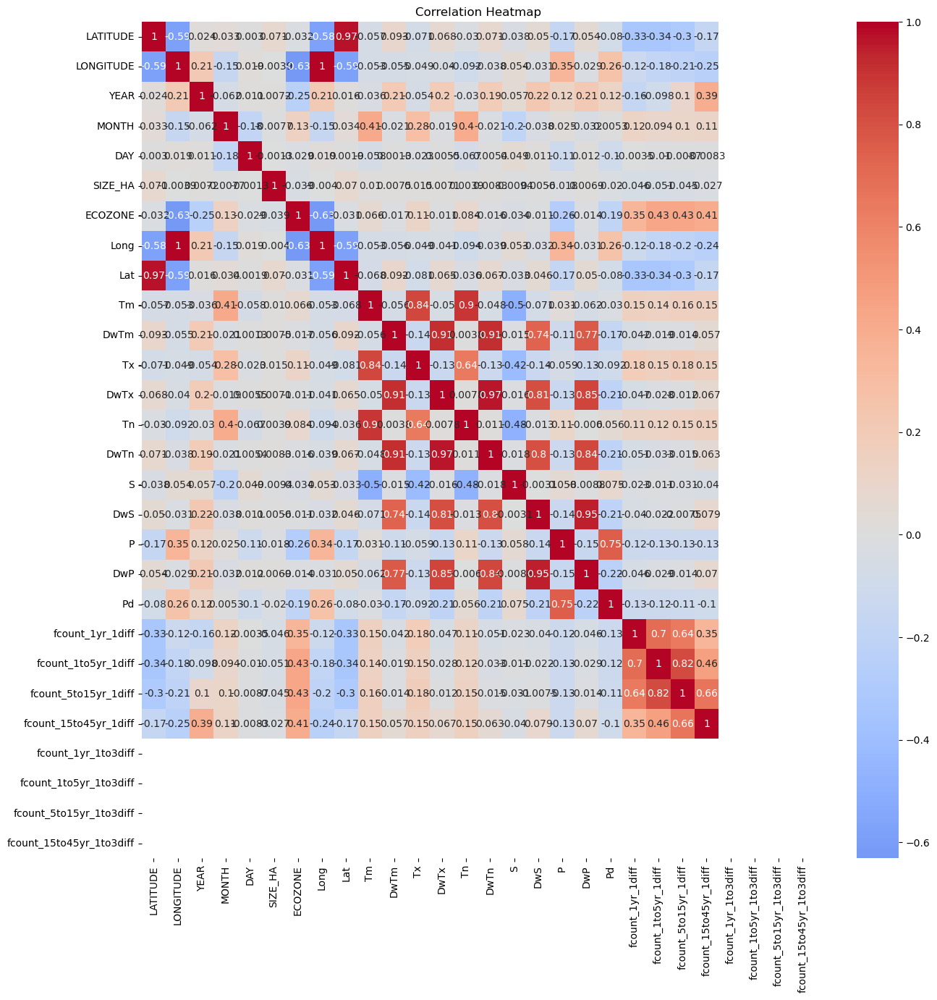

In [97]:
# Createing a correlation heatmap
plt.figure(figsize=(15, 15))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Heatmap')
plt.show()

Observations from correlation heatmap:
1. The `LATITUDE` from the fire data and `Lat` from the weather data have correlation. The `LONGITUDE` and `Long` columns as well have the same high correlation. Since we are more interested in the location and severity of future fire occurances, we will drop the `Lat` and `Long` column.
2. The `LONGITUDE` has a high correlation with `ECOZONE`. We are not concerned at the moment since we will eventually binarize that feature.
3. The `MONTH` feature has some correlation with the `Tm` and `Tn` feature. We will keep this for now since we might combine all the date features to have a single datetime value.
4. The `Tm` feature has high correlation with `Tn` and `Tx`. This could be because `Tn` has the lowest minimum temperature while `Tn` is the highest maximum temperature. Since `Tm` is the mean temperature, it could show the correlation. We will drop the `Tn` and `Tm` features to avoid correlation. It also has some correlation with `S`. The colder mean temperature would provide the conditions for snowy weather. We might consider dropping this column in the future since most of the wildland fires happen during the summer when there is little to no snow.
5. The `DwTm` feature has very high correlation with `DwP`, `DwS`, `DwTn`, and `DwTx`. Since it has extremly high correlation with a lot of other features, we will drop this feature. We will aslo end up dropping `DwTn` and `DwTx`. 
6. The `DwP` feature has very high correlation with `DwS`. We will drop the `DwS` feature.
7. The `Pd` feature has very high correlation with the `P` feature. The `P` feature gives us more information since it gives us the amount of precipitation for the month rather than just the number of days of precipitation. We will drop the `Pd` feature. 

In [98]:
# Dropping high correlation collumns
df.drop(columns=['Lat', 'Long', 'Tn', 'Tm', 'DwTn', 'DwTx', 'DwS', 'Pd'], inplace=True)

Combine Day Month Year into datetime

# Part 3: Initial Modeling <a id="3"></a>

We will begin creating our initial model. To try to get a good baseline model, we will look into ways to get data ready to be fed into a model.

## Binarizing <a id="3.1"></a>

We will start with binarizing our data. We will look at all the categorical columns in our dataset. 

In [99]:
# Filter columns with object data type
object_columns = df.select_dtypes(include=['object'])
object_columns.columns

Index(['SRC_AGENCY', 'FIRE_ID', 'FIRENAME', 'REP_DATE', 'DECADE', 'CAUSE',
       'MORE_INFO', 'CFS_REF_ID', 'CFS_NOTE1', 'CFS_NOTE2', 'ECOZ_NAME',
       'date_to_match', 'Date', 'Stn_Name', 'Prov_or_Ter'],
      dtype='object')

There are a few columns that do not make sense to binarize.
1. REP_DATE: This is the date when the fire occurance was reported to the Government of Canada. It does not tell us any useful information about the fire occurance itself. It just explains the timeline for record keeping. 
2. DECADE: Since we have date information, we would no longer need a separate column for just the decade.
3. Prov_or_Ter: This feature only tells us where the weather location is located. Although we could use it to extrapolate where the fire originated, we already have more accurate information from the `SRC_AGENCY` feature which is the reporting government agency where the fire occurance is located.
4. Date: This feature tells us the month and year of the weather data. We can gain this information as well from the fire data since we have matched and merged the datasets. This would be redundant information.
5. date_to_match: This is also a date feature we used to compare the weather and fire datasets. Since this is a feature we created based on existing data, we will drop this feature as well. 
6. Stn_Name: This feature only holds the weather station name that is closest to the fire. It does not contain additonal information that could tell us about the fire. We will drop this feature as well. 

Because of the above reasons, we will choose to drop all 6 of these features. We will also look into the other features with 'object' value types to see if these can be binarized.

In [100]:
# Dropping columns based on resoning above
df.drop(columns=['REP_DATE', 'DECADE', 'Prov_or_Ter', 'Date', 'date_to_match', 'Stn_Name'], inplace=True)

# Sanity check and to relook at column names of other `object` value types
object_columns = df.select_dtypes(include=['object'])
object_columns.columns

Index(['SRC_AGENCY', 'FIRE_ID', 'FIRENAME', 'CAUSE', 'MORE_INFO', 'CFS_REF_ID',
       'CFS_NOTE1', 'CFS_NOTE2', 'ECOZ_NAME'],
      dtype='object')

`FIRE_ID`

In [101]:
# Checking value counts 
df['FIRE_ID'].value_counts()

unknown        165
COC1            56
COC2            55
COC6            53
KEN1            52
              ... 
1994-K20223      1
1994-K40003      1
1994-K40006      1
1994-K40015      1
2021WP001        1
Name: FIRE_ID, Length: 283782, dtype: int64

There are 283782 unique values of `FIRE_ID`. Since it wouldn't make sense to create that many dummy columns and there seems to be no pattern in the values, we will drop this feature.

In [102]:
# Dropping columns based on resoning above
df.drop(columns=['FIRE_ID'], inplace=True)

`FIRENAME`

In [103]:
# Checking value counts 
df['FIRENAME'].value_counts(normalize=True)

                                 0.864613
DL1002                           0.000086
DF1006                           0.000083
DF1005                           0.000081
DL1001                           0.000081
                                   ...   
07PN-PNIR34                      0.000003
09PN-MERRIT                      0.000003
CLIFF FIRE                       0.000003
DECHAMBEAULT                     0.000003
WAP 24 pond fire / WNP-21-001    0.000003
Name: FIRENAME, Length: 25112, dtype: float64

There are 332,941 occurances with a blank or space as fire name. Since this represents more than 86% of our data, we will drop this feature as well. 

In [104]:
# Dropping columns based on resoning above
df.drop(columns=['FIRENAME'], inplace=True)

`MORE_INFO`

In [105]:
df['MORE_INFO'].value_counts()

                                                    342362
fueltype: C2                                          9582
fueltype:                                             6877
fueltype: O1a                                         4184
Actioned                                              3790
                                                     ...  
Sidney Creek                                             1
south of sidney creek                                    1
Thomas Creek                                             1
Solitary Creek - North Big Salmon                        1
AreaConfidence: Initial Estimate / Holdover fire         1
Name: MORE_INFO, Length: 2105, dtype: int64

There are 2105 unique value types in the feature. Based on the sample of the data above, it does not show any pattern in the values stored. Some entries describe location or fuel type. 342,362 instances just have a space as an entry. Because of all of this, we will drop this feature as well. 

In [106]:
# Dropping columns based on resoning above
df.drop(columns=['MORE_INFO'], inplace=True)

`CFS_REF_ID`

In [107]:
# Checking value counts 
df['CFS_REF_ID'].value_counts()

NL-1976-NA              32
NL-1961-NA              22
MB-1993-5-02-0-93       20
MB-1993-1-07-0-93       18
NL-1974-NA              17
                        ..
BC-2014-2014-G70525      1
BC-2014-2014-G70403      1
BC-2014-2014-G70392      1
BC-2014-2014-G70254      1
PC-WP-2021-2021WP001     1
Name: CFS_REF_ID, Length: 383679, dtype: int64

There are 383,679 unique values. Based on the sampling of the data, it seems like the values are a combination of different other features in the fire dataset. Some of the values are just the province/year while some have province/year/reference number. Since there would be also too many columns to binarize, we will drop this feature. 

In [108]:
# Dropping columns based on resoning above
df.drop(columns=['CFS_REF_ID'], inplace=True)

`CFS_NOTE1` & `CFS_NOTE2`

In [109]:
# Checking value counts 
print(df['CFS_NOTE1'].value_counts())
print(df['CFS_NOTE2'].value_counts())

                                                    370980
verify fireid                                         7284
used firepoly centroid for MB 2000-2004               2896
merged with orig src                                  2000
location not ignition - coords derived from poly       562
                                                     ...  
Verify fireid. Src fire_num: 23                          1
Verify fireid. Src fire_num: 33                          1
Verify fireid. Src fire_num: 29                          1
Verify fireid. Src fire_num: 28                          1
Verify fireid. Src fire_num: 37                          1
Name: CFS_NOTE1, Length: 66, dtype: int64
                                                          384465
Note that src coordinates outside Park/agency boundary       179
removed duplicate                                            160
day n/a from src                                             120
removed nfdb duplicate                           

Both features have a lot of spaces as the input data. Based on the sampling, there is no discernable pattern of information avaiable in the feature. We will drop these as well.

In [110]:
# Dropping columns based on resoning above
df.drop(columns=['CFS_NOTE1', 'CFS_NOTE2'], inplace=True)

# Sanity check to make sure all columns are droped. 
object_columns = df.select_dtypes(include=['object'])
object_columns.columns

Index(['SRC_AGENCY', 'CAUSE', 'ECOZ_NAME'], dtype='object')

We are now left with `SRC_AGENCY`, `CAUSE`, and `ECOZ_NAME` as features to binarize.

In [111]:
# Creating dummy columns
df = pd.get_dummies(df, columns=['SRC_AGENCY', 'CAUSE', 'ECOZ_NAME'])
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 385075 entries, 0 to 423830
Data columns (total 55 columns):
 #   Column                        Non-Null Count   Dtype         
---  ------                        --------------   -----         
 0   LATITUDE                      385075 non-null  float64       
 1   LONGITUDE                     385075 non-null  float64       
 2   YEAR                          385075 non-null  int64         
 3   MONTH                         385075 non-null  int64         
 4   DAY                           385075 non-null  int64         
 5   SIZE_HA                       385075 non-null  float64       
 6   ECOZONE                       385075 non-null  int64         
 7   DwTm                          385075 non-null  float64       
 8   Tx                            385075 non-null  float64       
 9   S                             385075 non-null  float64       
 10  P                             385075 non-null  float64       
 11  DwP          

Now that we have created dummy columns, we will drop one dummy feature from each of the original features to avoid collienarity. We will choose the following features.
1. SRC_AGENCY_NL: They seem to have the lower counts for wildland fire occurances compared to other agencies.
2. CAUSE_U: These are unknown causes and therefore would be hard to interpret.
3. ECOZ_NAME_: Represents the smallest fraction of our ecozone data.

We will also drop `ECOZONE` since it is a numerical representation of the `ECOZ_NAME` feature that we have created dummies. 

In [112]:
# Dropping columns based on resoning above
df.drop(columns=['SRC_AGENCY_NL', 'CAUSE_U', 'ECOZ_NAME_ ', 'ECOZONE'], inplace=True)

In [113]:
df.drop(columns=['FIRE_DATE', 'YEAR'], inplace=True)

In [114]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 385075 entries, 0 to 423830
Data columns (total 49 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   LATITUDE                      385075 non-null  float64
 1   LONGITUDE                     385075 non-null  float64
 2   MONTH                         385075 non-null  int64  
 3   DAY                           385075 non-null  int64  
 4   SIZE_HA                       385075 non-null  float64
 5   DwTm                          385075 non-null  float64
 6   Tx                            385075 non-null  float64
 7   S                             385075 non-null  float64
 8   P                             385075 non-null  float64
 9   DwP                           385075 non-null  float64
 10  fcount_1yr_1diff              385075 non-null  int64  
 11  fcount_1to5yr_1diff           385075 non-null  int64  
 12  fcount_5to15yr_1diff          385075 non-nul

## Target Variable Transformation <a id="3.2"></a>

We will look into transforming our target variable to get ready for modeling. To guide our process, we looked at information and research done by CIFFC (Canadian Interagency Forest Fire Centre)

Not all agencies and local/provincial government bodies have fire size classifications. To help standardize this, the CIFFC developed a classification system that is easily adaptable.
<br>
<br>
| Number | Letter | Area (Hectares) |
|--------|--------|-----------------|
| 1 | A | Upto 0.1 |
| 2 | B | 0.11 – 1.0 |
| 3 | C | 1.1 – 10 |
| 4 | D | 10.1 – 100 |
| 5 | E | 100.1 – 1,000 |
| 6 | F | 1,000.1 – 10,000 |
| 7 | G | 10,000.1 – 100,000 |
| 8 | H | Over 100,000 |

<br>
<br>
source: chrome-extension://efaidnbmnnnibpcajpcglclefindmkaj/https://www.ciffc.ca/sites/default/files/2019-03/Developing_More_Common_Terminolgy_-_Final_Report.pdf

In [115]:
# Looking at distribution of size
df['SIZE_HA'].describe()

count    3.850750e+05
mean     3.478987e+02
std      5.891963e+03
min      1.000000e-05
25%      1.000000e-01
50%      2.000000e-01
75%      1.500000e+00
max      1.050000e+06
Name: SIZE_HA, dtype: float64

Recap of target variable information based on inital EDA.
1. Fire size is heavily skewed towards smaller fires. 25% of the fires are less than 0.1 hectares. The 50th percentile only sits at 0.2 hectares.
2. The largest fire occurance burned down 1,050,000 hectares. The average fire size is at 347.89 hectares. This is mostly due to the extremly large fire occurances brining the averge up. 

Based on the distribution of our fire data and classifcation system created by the CIFFC, we will group our data into 4 buckets

| Number | Area (Hectares) |
|--------|-----------------|
| 1 | Upto 0.1 |
| 2 | 0.11 – 1.0 |
| 3 | 1.1 – 10 |
| 4 | 10.1 - 100 |
| 5 | 100.01 - 1000 |
| 6 | over 1000 |

In [116]:
# Creating bins for SIZE_HA feature based on decision above
bin_borders = [0, 0.1, 1, 10, 100, 1000, float('inf')]
bin_labels = [1, 2 ,3, 4, 5, 6]

# Creating new target variable
df['severity'] = pd.cut(df['SIZE_HA'], bins=bin_borders, labels=bin_labels, right=False)

# Dropping old target variable
df.drop(columns=['SIZE_HA'], inplace=True)

In [117]:
# Sanity check
df['severity'].value_counts(normalize=True)*100

2    56.447445
3    17.729533
1    13.139518
4     6.560280
5     3.469454
6     2.653769
Name: severity, dtype: float64

In [118]:
# Dropping high correlation collumns
#df.drop(columns=['fcount_1yr_1to2diff'], inplace=True)

# Saving the final dataset into a csv
df.to_csv('capstone_modeling_data.csv')

## Train/Test Split <a id="3.3"></a>

We will create a train/test split to help us in building a more reliable and effective machine learning model by enabling unbiased evaluation and assessment of their performance on unseen data.

In [119]:
# Defining X(independent) and y(target) variables
X = df.drop(columns=['severity'])
y = df['severity']

# Sanity check
print(f"The shape of our indpendent features is {X.shape}")
print(f"The shape of our target variable is {y.shape}")

The shape of our indpendent features is (385075, 48)
The shape of our target variable is (385075,)


Now that we have defined our independent and target variables we will now split our data. We will create 3 groups of our data; the train, validation, and test data. This way we avoid data leakage when training and hypertuning our models to get as real results as possible.

In [120]:
# Splitting to extract test set
X_remainder, X_test, y_remainder, y_test = train_test_split(X, y, test_size = 0.2, random_state=1)

# Splitting again to get train and validation set
X_train, X_validation, y_train, y_validation = train_test_split(X_remainder, y_remainder, test_size = 0.3, random_state=1)

# Sanity check
print(f"The shape of our X_test is {X_test.shape}")
print(f"The shape of our y_test is {y_test.shape}")
print(f"The shape of our X_train is {X_train.shape}")
print(f"The shape of our y_train is {y_train.shape}")
print(f"The shape of our X_validation is {X_validation.shape}")
print(f"The shape of our y_validation is {X_validation.shape}")

The shape of our X_test is (77015, 48)
The shape of our y_test is (77015,)
The shape of our X_train is (215642, 48)
The shape of our y_train is (215642,)
The shape of our X_validation is (92418, 48)
The shape of our y_validation is (92418, 48)


## Scaling  <a id="3.4"></a>

We will take another quick look at our features to see if scaling is required.

In [121]:
# Checking feature names and value types
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 385075 entries, 0 to 423830
Data columns (total 49 columns):
 #   Column                        Non-Null Count   Dtype   
---  ------                        --------------   -----   
 0   LATITUDE                      385075 non-null  float64 
 1   LONGITUDE                     385075 non-null  float64 
 2   MONTH                         385075 non-null  int64   
 3   DAY                           385075 non-null  int64   
 4   DwTm                          385075 non-null  float64 
 5   Tx                            385075 non-null  float64 
 6   S                             385075 non-null  float64 
 7   P                             385075 non-null  float64 
 8   DwP                           385075 non-null  float64 
 9   fcount_1yr_1diff              385075 non-null  int64   
 10  fcount_1to5yr_1diff           385075 non-null  int64   
 11  fcount_5to15yr_1diff          385075 non-null  int64   
 12  fcount_15to45yr_1diff         

We have a mix of categorical (features that were created using dummies) and continous features. Our numerical features do not record the information in the same way. For example, the amount of precipitation is measured in mm while snow is in cm. That is a difference of factor of 10. DwTm and DwP are measured in number of days while Tm is measured in celcius. Because of these issues, we have decided that we will need to scale the data. We will fit the scaler only on the train data then transform both the validation and test sets. This way we avoid data leakage.

In [122]:
X_train

,LATITUDE,LONGITUDE,MONTH,DAY,DwTm,Tx,S,P,DwP,fcount_1yr_1diff,...,ECOZ_NAME_MixedWood Plain,ECOZ_NAME_Montane Cordillera,ECOZ_NAME_Northern Arctic,ECOZ_NAME_Pacific Maritime,ECOZ_NAME_Prairie,ECOZ_NAME_Southern Arctic,ECOZ_NAME_Taiga Cordillera,ECOZ_NAME_Taiga Plain,ECOZ_NAME_Taiga Shield East,ECOZ_NAME_Taiga Shield West
FID,,,,,,,,,,,,,,,,,,,,,
119145,50.037500,-125.597500,5,16,2.0,20.5,0.0,40.8,0.0,15,...,0,0,0,1,0,0,0,0,0,0
421997,58.666317,-112.740550,8,7,0.0,29.0,0.0,79.6,0.0,17,...,0,0,0,0,0,0,0,0,0,0
422475,51.130000,-118.084400,8,10,0.0,25.5,0.0,28.4,0.0,354,...,0,1,0,0,0,0,0,0,0,0
256551,55.932222,-100.220278,6,1,2.0,30.0,0.0,29.5,0.0,41,...,0,0,0,0,0,0,0,0,0,0
332265,45.524280,-76.132010,5,12,0.0,28.9,0.0,36.1,0.0,7,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
375133,47.570000,-52.820000,4,8,0.0,13.0,29.0,106.6,0.0,24,...,0,0,0,0,0,0,0,0,0,0
127097,50.699100,-118.329100,8,17,8.0,33.5,0.0,4.4,5.0,250,...,0,1,0,0,0,0,0,0,0,0
56223,52.532000,-122.575000,7,26,0.0,23.9,0.0,38.6,0.0,116,...,0,1,0,0,0,0,0,0,0,0


In [123]:
# Instantiate standard scaler
scaler = StandardScaler()

# Fitting only on train
scaler.fit(X_train)

# Transform train and test
X_train_scaled = scaler.transform(X_train)
X_validation_scaled = scaler.transform(X_validation)
X_test_scaled = scaler.transform(X_test)

## Baseline Model  <a id="3.5"></a>

We will begin creating a base model. For our base model, we will choose to use a simple logistic regression model. We want to pick one of the basic models because it is highly interpretable and less computationaly expensive.

Null Hypothesis: There is no relationship between the target variable and the independent features. <br>
Althernative Hypothesis: There is some relationship between the taret variable and the independent features. <br>

Assumptions:
1. There is a linear relationship between the dependent and independent variables.
2. The independent variables are independent of each other (no single or multicollinearity) and each is identically distributed.
3. Residuals are normally distributed. That is, they follow a normal (bell curve) distribution.
4. The variance of residuals is consistent across the entire range of data.

In [124]:
# Instantiate, fit, and score the model
log_model = LogisticRegression(max_iter=10000)
log_model.fit(X_train_scaled, y_train)
log_y_train_pred = log_model.predict(X_train_scaled)
log_y_val_pred = log_model.predict(X_validation_scaled)

# Looking at scores
log_train_acc = log_model.score(X_train_scaled, y_train)
log_val_acc = log_model.score(X_validation_scaled, y_validation)
log_train_recall = recall_score(y_train, log_y_train_pred, average='weighted')
log_val_recall = recall_score(y_validation, log_y_val_pred, average='weighted')

# Printing scores
print(f"Our first model has a train accuracy score of {log_train_acc}")
print(f"Our first model has a validation accuracy score of {log_val_acc}")
print(f"Our first model has a train recall score of {log_train_recall}")
print(f"Our first model has a validation recall score of {log_val_recall}")

Our first model has a train accuracy score of 0.5806058189035531
Our first model has a validation accuracy score of 0.5789348395334242
Our first model has a train recall score of 0.5806058189035531
Our first model has a validation recall score of 0.5789348395334242


We have decent accuracy score. Our train and validation scores are close to each other. It doesn't look like we are seeing over or under fitting. We will look at fixing our hyperparameters to try to increase our accuracy.

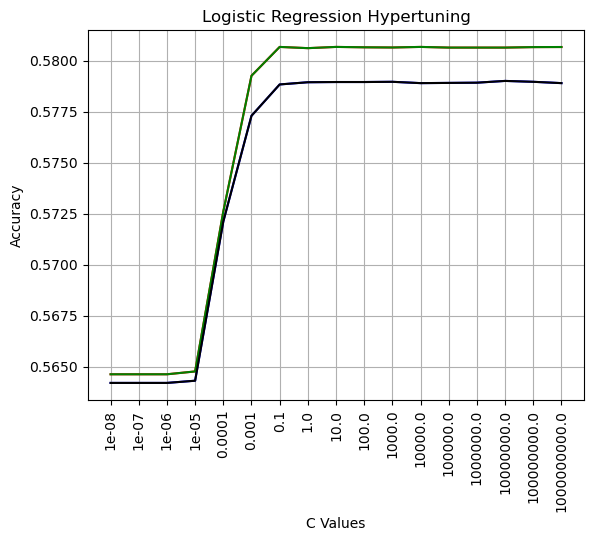

In [125]:
# Creating range for hyperparmater C
c_range = np.array([.00000001,.0000001,.000001,.00001,.0001,.001,0.1,1,10,100,1000,10000,100000,1000000,10000000,100000000,1000000000])

# Creating empty lists to append values to
train_accuracy = []
validation_accuracy = []
train_recall = []
validation_recall = []

for c in c_range:
    log_model = LogisticRegression(C=c, max_iter=10000)
    log_model.fit(X_train_scaled, y_train)
    log_y_train_pred = log_model.predict(X_train_scaled)
    log_y_val_pred = log_model.predict(X_validation_scaled)
    
    # Retrieving scores
    train_acc_score = log_model.score(X_train_scaled, y_train)
    validation_acc_score = log_model.score(X_validation_scaled, y_validation)
    train_recall_score = recall_score(y_train, log_y_train_pred, average='weighted')
    validation_recall_score = recall_score(y_validation, log_y_val_pred, average='weighted')
    
    # Appending into list
    train_accuracy.append(train_acc_score)
    validation_accuracy.append(validation_acc_score)
    train_recall.append(train_recall_score)
    validation_recall.append(validation_recall_score)
    
# Plotting
plt.figure
sns.lineplot(data=train_accuracy, color='red')
sns.lineplot(data=validation_accuracy, color='blue')
sns.lineplot(data=train_recall, color='green')
sns.lineplot(data=validation_recall, color='black')
plt.xlabel('C Values')
plt.ylabel('Accuracy')
plt.xticks(ticks= np.arange(0, 17, 1), labels=c_range, rotation='vertical')
plt.title('Logistic Regression Hypertuning')
plt.grid()
plt.show()

In [126]:
# Instantiate, fit, and score the model
log_model_final = LogisticRegression(C=0.1, max_iter=10000)
log_model_final.fit(X_train_scaled, y_train)
log_y_train_pred = log_model_final.predict(X_train_scaled)
log_y_val_pred = log_model_final.predict(X_validation_scaled)

# Looking at scores
log_final_train_acc = log_model_final.score(X_train_scaled, y_train)
log_final_val_acc = log_model_final.score(X_validation_scaled, y_validation)
log_final_train_recall = recall_score(y_train, log_y_train_pred, average='weighted')
log_final_val_recall = recall_score(y_validation, log_y_val_pred, average='weighted')

# Printing scores
print(f"Our final model has a train accuracy score of {log_final_train_acc}")
print(f"Our final model has a validation accuracy score of {log_final_val_acc}")
print(f"Our final model has a train recall score of {log_final_train_recall}")
print(f"Our final model has a validation recall score of {log_final_val_recall}")

Our final model has a train accuracy score of 0.5806661040057132
Our final model has a validation accuracy score of 0.5788266355039061
Our final model has a train recall score of 0.5806661040057132
Our final model has a validation recall score of 0.5788266355039061


## Model Evaluation Metrics  <a id="3.6"></a>

Now that we have our baseline models, we will look at which metrics to use and compare future models with. Since we are trying to predict severity, we would rather err on the side of caution to make sure we are not missing potentially severe wildland fires. We will look at accuracy to see overall performance but also recall to hopefully lower false negatives in our predictions. 

#### Assumption: Using weighted average to calculate recall scores.

In [127]:
# Creating empty dataframe for scores
compiled_scores_df = pd.DataFrame(columns=['Model', 'Hyperparamater', 'Train_Accuracy', 'Validation_Accuracy', 'Train_Recall', 'Validation_Recall', 'Notes'])

In [128]:
# Appending into scores dataframe
inital_log_model = {'Model': 'Logistic', 'Hyperparamater': 'None', 
                    'Train_Accuracy': log_train_acc, 'Validation_Accuracy': log_val_acc, 
                    'Train_Recall': log_train_recall, 'Validation_Recall': log_val_recall, 
                    'Notes': 'Initial Model'}
final_log_model = {'Model': 'Logistic', 'Hyperparamater': 'C=0.1', 
                    'Train_Accuracy': log_final_train_acc, 'Validation_Accuracy': log_final_val_acc, 
                    'Train_Recall': log_final_train_recall, 'Validation_Recall': log_final_val_recall, 
                    'Notes': 'Increasing C values has no further effect on accuracy or recall'}

compiled_scores_df = compiled_scores_df.append(inital_log_model, ignore_index=True)
compiled_scores_df = compiled_scores_df.append(final_log_model, ignore_index=True)
compiled_scores_df

C:\Users\nicod\AppData\Local\Temp\ipykernel_24656\1251847936.py:11: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\nicod\AppData\Local\Temp\ipykernel_24656\1251847936.py:12: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,Model,Hyperparamater,Train_Accuracy,Validation_Accuracy,Train_Recall,Validation_Recall,Notes
0,Logistic,None,0.580606,0.578935,0.580606,0.578935,Initial Model
1,Logistic,C=0.1,0.580666,0.578827,0.580666,0.578827,Increasing C values has no further effect on a...


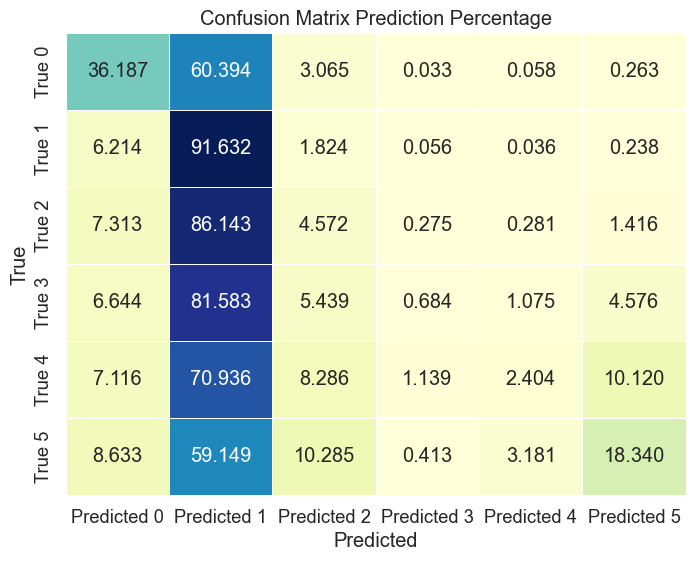

In [133]:
# Generate soft predictions
log_y_val_pred = log_model_final.predict(X_validation_scaled)

# Generate confusion matrix using hard predictions
cf_matrix = confusion_matrix(y_validation, log_y_val_pred, normalize='true')

# create a dataframe for predictions
cftest_df = pd.DataFrame(cf_matrix*100, 
                         columns=['Predicted 0', 'Predicted 1', 'Predicted 2', 'Predicted 3', 'Predicted 4', 'Predicted 5'], 
                         index=['True 0', 'True 1', 'True 2', 'True 3', 'True 4', 'True 5']
                        )

# Plotting values
plt.figure(figsize=(8, 6))
sns.set(font_scale=1.2)  # Adjust font size
sns.heatmap(cftest_df, annot=True, fmt=".3f", cmap="YlGnBu", cbar=False, linewidths=0.5)
plt.title('Confusion Matrix Prediction Percentage')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

Insights from confusion matrix:
1. Our 58% accuracy was mainly due to the model predicting severity 1 correctly.
2. Severity 1 has the most number of occurances in our data. It is responsible for over 50% of all our occurances. 
3. Although the logistic model has a high recall score, is predicting all other severities as severity 1.
4. We will need to resample the data to allow the model to learn the more severe fire occurances. 

[Back to top](#top)